# Análise dos atributos dos cards em FUT20 e seus preços médios

## 1. Importação das Bibliotecas

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn import linear_model
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.model_selection import train_test_split
import statsmodels.api as sm
from numpy import random 
from math import pi
import matplotlib.ticker as mtick

In [2]:
pd.options.display.max_rows = 100
pd.options.display.max_columns = 30

## 2. Carregamento dos dados

### Carregamento do arquivo CSV com os atributos dos cards de FUT20

In [3]:
df_cards = pd.read_csv("D:\Documentos\TCC_Workspace\Base_de_dados_originais\\fut_bin20_players.csv",dtype={"origin": str})

In [4]:
df_cards.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25034 entries, 0 to 25033
Data columns (total 95 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   futbin_id             25034 non-null  int64  
 1   player_name           25034 non-null  object 
 2   player_extended_name  25034 non-null  object 
 3   quality               25034 non-null  object 
 4   revision              24743 non-null  object 
 5   origin                3795 non-null   object 
 6   overall               25034 non-null  int64  
 7   club                  25034 non-null  object 
 8   league                25034 non-null  object 
 9   nationality           25034 non-null  object 
 10  position              25034 non-null  object 
 11  age                   25034 non-null  int64  
 12  date_of_birth         25034 non-null  object 
 13  height                25027 non-null  float64
 14  weight                25034 non-null  int64  
 15  intl_rep           

### Carregamento do arquivo CSV com os preços de cards do FUT20

In [5]:
df_prices = pd.read_csv("D:\Documentos\TCC_Workspace\Base_de_dados_originais\\fut_bin20_prices.csv")

In [6]:
df_prices.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6764697 entries, 0 to 6764696
Data columns (total 5 columns):
 #   Column       Dtype 
---  ------       ----- 
 0   resource_id  int64 
 1   date         object
 2   ps4          int64 
 3   xbox         int64 
 4   pc           int64 
dtypes: int64(4), object(1)
memory usage: 258.1+ MB


#### Verificação de Zeros e Valores Faltantes

In [7]:
def missing_zero_values_table(df):
        zero_val = (df == 0).sum()
        zero_val_percent = (100 * (df == 0).sum() / len(df)).round(2)
        mis_val = df.isnull().sum()
        mis_val_percent = (100 * df.isnull().sum() / len(df)).round(2)
        mz_table = pd.concat([mis_val, mis_val_percent,zero_val, zero_val_percent], axis=1)
        mz_table = mz_table.rename(
        columns = {0 : 'Missing Values', 1 : '% of Missing Values', 2 :'Zero Values' , 3 : '% of Zero Values'})
        mz_table['Total Zero or Missing Values'] = mz_table['Zero Values'] + mz_table['Missing Values']
        mz_table['% Total Zero or Missing Values'] = (100 * mz_table['Total Zero or Missing Values'] / len(df)).round(2)
        mz_table['Data Type'] = df.dtypes
        mz_table_count = mz_table[mz_table.iloc[:,5] != 0]
        print ("Your selected dataframe has " + str(df.shape[1]) + " columns and " + str(df.shape[0]) + " Rows.\n"      
            "There are " + str(mz_table_count.shape[0]) +
              " columns that have missing values.")
        return mz_table

missing_zero_values_table(df_prices)

Your selected dataframe has 5 columns and 6764697 Rows.
There are 3 columns that have missing values.


,Missing Values,% of Missing Values,Zero Values,% of Zero Values,Total Zero or Missing Values,% Total Zero or Missing Values,Data Type
resource_id,0,0.0,0,0.00,0,0.00,int64
date,0,0.0,0,0.00,0,0.00,object
ps4,0,0.0,55035,0.81,55035,0.81,int64
xbox,0,0.0,4212870,62.28,4212870,62.28,int64
pc,0,0.0,5323460,78.69,5323460,78.69,int64


#### Substituição de zeros por nan. Valores zero impactam o cálculo da média

In [8]:
df_prices[['ps4','xbox','pc']] = df_prices[['ps4','xbox','pc']].replace(0, np.nan)
missing_zero_values_table(df_prices)

Your selected dataframe has 5 columns and 6764697 Rows.
There are 3 columns that have missing values.


,Missing Values,% of Missing Values,Zero Values,% of Zero Values,Total Zero or Missing Values,% Total Zero or Missing Values,Data Type
resource_id,0,0.00,0,0.0,0,0.00,int64
date,0,0.00,0,0.0,0,0.00,object
ps4,55035,0.81,0,0.0,55035,0.81,float64
xbox,4212870,62.28,0,0.0,4212870,62.28,float64
pc,5323460,78.69,0,0.0,5323460,78.69,float64


#### Cálcuo da média diária entre plataformas e média geral por card

In [9]:
df_prices['avg_price'] = df_prices[['ps4','xbox','pc']].mean(axis=1)
pd.set_option('display.float_format', lambda x: '%.2f' % x) ## pd.reset_option('display.float_format') para reverter
df_avg_price = df_prices.groupby('resource_id')['avg_price'].mean().reset_index()
df_avg_price.head()

,resource_id,avg_price
0,41,3146.89
1,51,214053.31
2,80,967.13
3,240,316856.31
4,241,283379.94


## 3. Junção dos datasets de cards e preços

In [10]:
df = df_cards.join(df_avg_price.set_index('resource_id'), on='resource_id')
df.head()

,futbin_id,player_name,player_extended_name,quality,revision,origin,overall,club,league,nationality,position,age,date_of_birth,height,weight,...,base_id,resource_id,ps4_last,ps4_min,ps4_max,ps4_prp,xbox_last,xbox_min,xbox_max,xbox_prp,pc_last,pc_min,pc_max,pc_prp,avg_price
0,1,Pelé,Edson Arantes Nascimento,Gold - Rare,Icon,Prime,98,Icons,Icons,Brazil,CAM,79,1940-10-23,173.00,70,...,237067,237067,4200000.00,335000.00,6400000.00,63,3499000.00,285000.00,5400000.00,62,nan,524000.00,10000000.00,100,5151900.25
1,2,Maradona,Diego Maradona,Gold - Rare,Icon,Prime,97,Icons,Icons,Argentina,CAM,59,1960-10-30,165.00,70,...,190042,190042,3484000.00,196000.00,3700000.00,93,2000000.00,157000.00,3000000.00,64,nan,181000.00,3400000.00,67,3044962.56
2,3,Ronaldo,Ronaldo Luís Nazário de Lima,Gold - Rare,Icon,Prime,96,Icons,Icons,Brazil,ST,44,1976-09-22,183.00,78,...,37576,37576,12390000.00,1145000.00,15000000.00,81,nan,650000.00,12300000.00,68,nan,1169000.00,15000000.00,63,10963113.33
3,4,Pelé,Edson Arantes Nascimento,Gold - Rare,Icon,Medium,95,Icons,Icons,Brazil,CF,79,1940-10-23,173.00,69,...,237068,237068,2270000.00,210000.00,4000000.00,54,2149000.00,213000.00,4000000.00,51,nan,280000.00,5300000.00,89,3890103.61
4,5,Maradona,Diego Maradona,Gold - Rare,Icon,Medium,95,Icons,Icons,Argentina,CAM,59,1960-10-30,165.00,72,...,237074,237074,1420000.00,112000.00,2100000.00,65,1499000.00,93500.00,1800000.00,82,nan,118000.00,2200000.00,90,1823811.21


#### Verificação de Null ou zeros no novo dataset

#### Representação gráfica da nulidade por campo

Your selected dataframe has 96 columns and 25034 Rows.
There are 80 columns that have missing values.


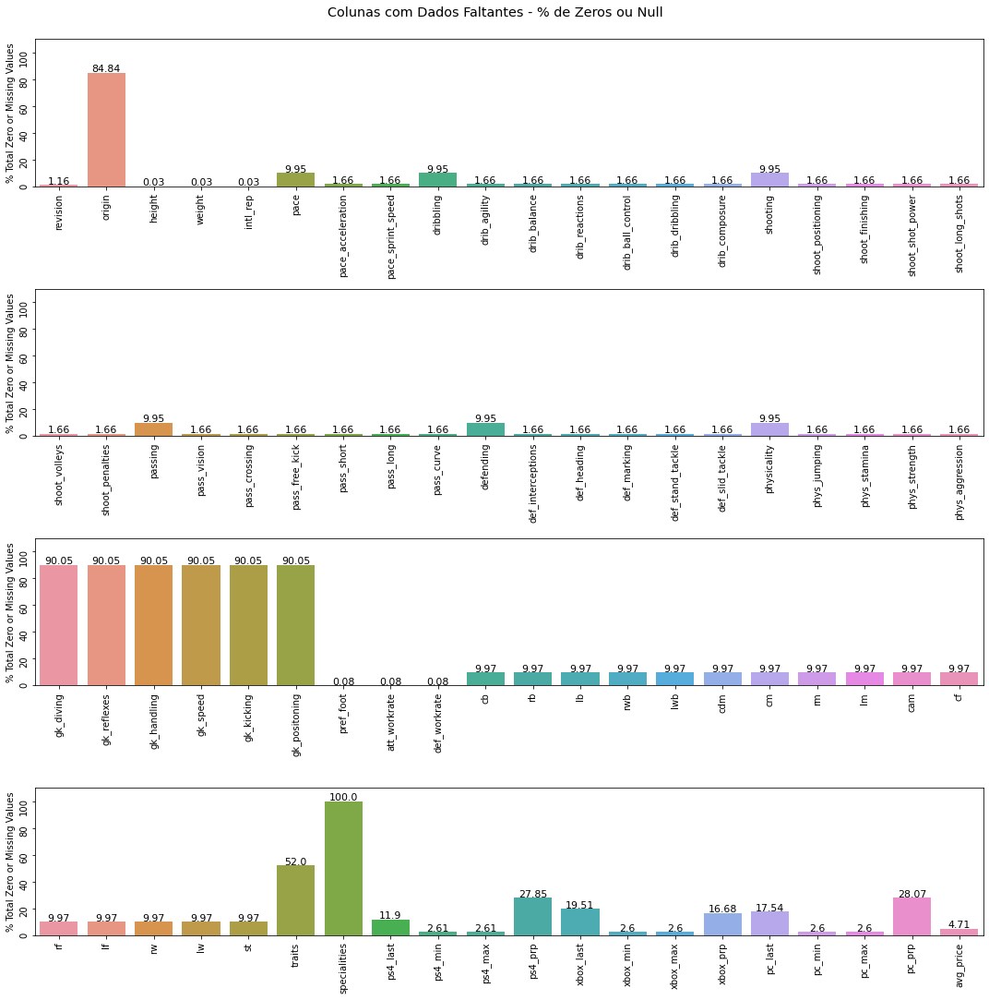

In [11]:
def missing_zero_values_table_filtered(df):
        zero_val = (df == 0).sum()
        zero_val_percent = (100 * (df == 0).sum() / len(df)).round(2)
        mis_val = df.isnull().sum()
        mis_val_percent = (100 * df.isnull().sum() / len(df)).round(2)
        mz_table = pd.concat([mis_val, mis_val_percent,zero_val, zero_val_percent], axis=1)
        mz_table = mz_table.rename(
        columns = {0 : 'Missing Values', 1 : '% of Missing Values', 2 :'Zero Values' , 3 : '% of Zero Values'})
        mz_table['Total Zero or Missing Values'] = mz_table['Zero Values'] + mz_table['Missing Values']
        mz_table['% Total Zero or Missing Values'] = (100 * mz_table['Total Zero or Missing Values'] / len(df)).round(2)
        mz_table['Data Type'] = df.dtypes
        mz_table_count = mz_table[mz_table.iloc[:,5] != 0]
        print ("Your selected dataframe has " + str(df.shape[1]) + " columns and " + str(df.shape[0]) + " Rows.\n"      
            "There are " + str(mz_table_count.shape[0]) +
              " columns that have missing values.")
        return mz_table_count


df_filtered = missing_zero_values_table_filtered(df)

n_part = len(df_filtered)
part_1 = df_filtered[0:20]
part_2 = df_filtered[20:40]
part_3 = df_filtered[40:60]
part_4 = df_filtered[60:80]

fig, ax = plt.subplots(4,1,figsize = (15,15))

sns.barplot(ax=ax[0],x=part_1.index, y='% Total Zero or Missing Values',data=part_1)
sns.barplot(ax=ax[1],x=part_2.index, y='% Total Zero or Missing Values',data=part_2)
sns.barplot(ax=ax[2],x=part_3.index, y='% Total Zero or Missing Values',data=part_3)
sns.barplot(ax=ax[3],x=part_4.index, y='% Total Zero or Missing Values',data=part_4)
for ax in fig.axes:
    ax.tick_params(labelrotation=90)
    ax.set(ylim=(0, 110))
    for rect in ax.patches:
        ax.text (rect.get_x() + rect.get_width()  / 2,
                    rect.get_height()+ 0.75,
                    rect.get_height(),
                    horizontalalignment='center', 
                    fontsize = 11)

plt.suptitle("Colunas com Dados Faltantes - % de Zeros ou Null", fontsize="x-large", y=1.0)   
plt.tight_layout()
plt.show()


#### Supressão de colunas irrelevantes

In [12]:
df.drop(columns=['origin','gk_diving','gk_reflexes','gk_handling','gk_speed','gk_kicking','gk_positoning',
                 'traits','specialities','ps4_last','ps4_min','ps4_max','ps4_prp','xbox_last','xbox_min',
                 'xbox_max','xbox_prp','pc_last','pc_min','pc_max','pc_prp'], inplace=True) 

#### Filtro de Atributos e Sub-Atributos

In [13]:
df = df[['player_name', 'revision', 'overall', 'position', 'age', 'height', 'weight', 'pace', 'pace_acceleration', 
         'pace_sprint_speed', 'dribbling', 'drib_agility', 'drib_balance', 'drib_reactions', 'drib_ball_control', 
         'drib_dribbling', 'drib_composure', 'shooting', 'shoot_positioning', 'shoot_finishing', 'shoot_shot_power', 
         'shoot_long_shots', 'shoot_volleys', 'shoot_penalties', 'passing', 'pass_vision', 'pass_crossing', 'pass_free_kick', 
         'pass_short', 'pass_long', 'pass_curve', 'defending', 'def_interceptions', 'def_heading', 'def_marking', 
         'def_stand_tackle', 'def_slid_tackle', 'physicality', 'phys_jumping', 'phys_stamina', 'phys_strength', 
         'phys_aggression', 'skill_moves', 'resource_id', 'avg_price']]

#### Reavaliação de Faltantes

Your selected dataframe has 45 columns and 25034 Rows.
There are 39 columns that have missing values.


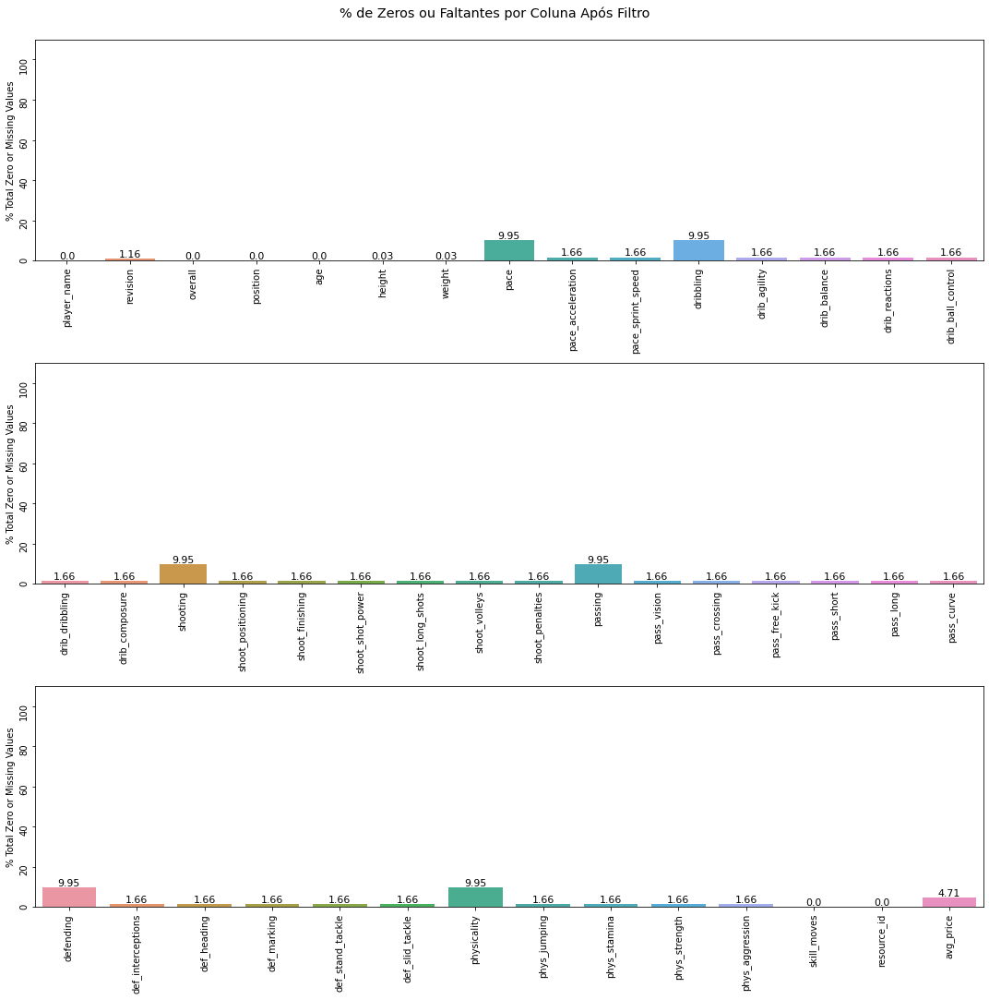

In [14]:
df_filtered = missing_zero_values_table(df)
n_part = len(df_filtered)
part_1 = df_filtered[0:15]
part_2 = df_filtered[15:31]
part_3 = df_filtered[31:45]

fig, ax = plt.subplots(3,1,figsize = (15,15))

sns.barplot(ax=ax[0],x=part_1.index, y='% Total Zero or Missing Values',data=part_1)
sns.barplot(ax=ax[1],x=part_2.index, y='% Total Zero or Missing Values',data=part_2)
sns.barplot(ax=ax[2],x=part_3.index, y='% Total Zero or Missing Values',data=part_3)

for ax in fig.axes:
    ax.tick_params(labelrotation=90)
    ax.set(ylim=(0, 110))
    for rect in ax.patches:
        ax.text (rect.get_x() + rect.get_width()  / 2,
                    rect.get_height()+ 0.75,
                    rect.get_height(),
                    horizontalalignment='center', 
                    fontsize = 11)

plt.suptitle("% de Zeros ou Faltantes por Coluna Após Filtro", fontsize="x-large", y=1.0)   
plt.tight_layout()
plt.show()

#### Remoção de Registros sem Preço

In [15]:
df = df[df['avg_price'].notna()]

Your selected dataframe has 45 columns and 23854 Rows.
There are 38 columns that have missing values.


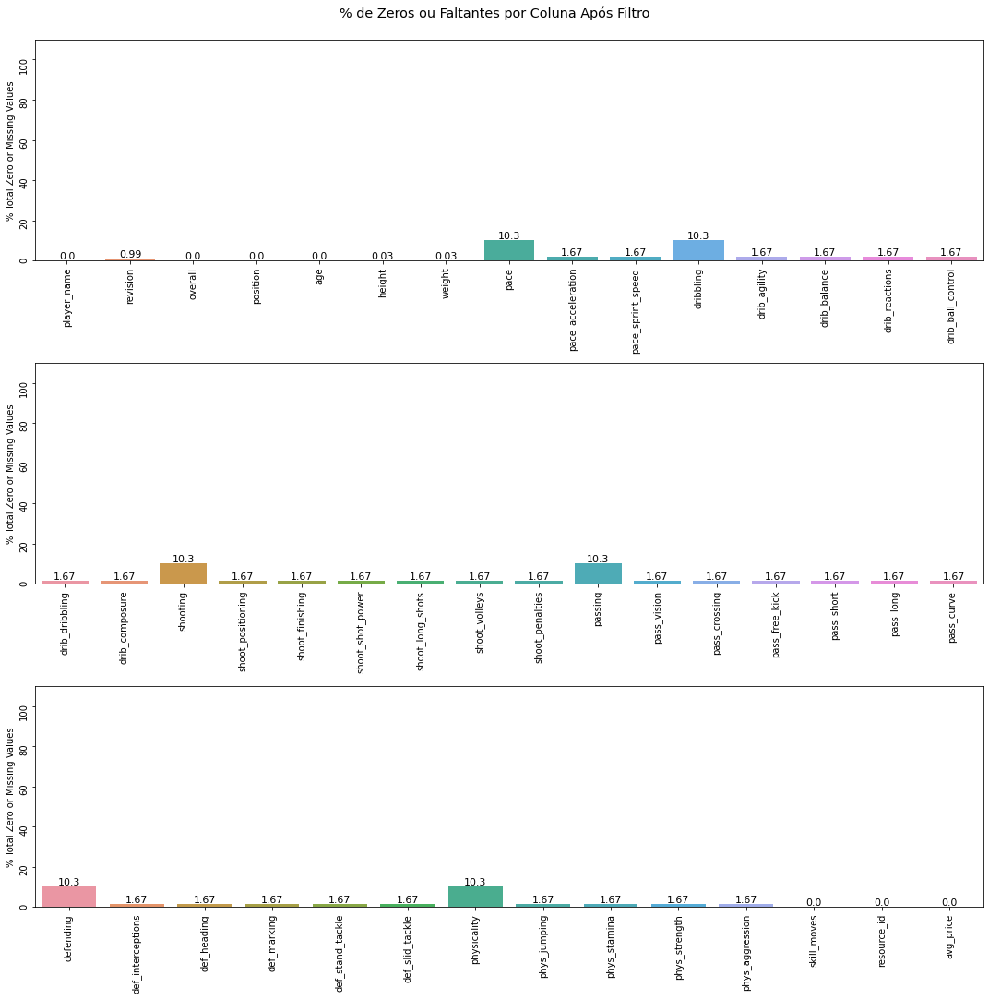

In [16]:
df_filtered = missing_zero_values_table(df)
n_part = len(df_filtered)
part_1 = df_filtered[0:15]
part_2 = df_filtered[15:31]
part_3 = df_filtered[31:45]

fig, ax = plt.subplots(3,1,figsize = (15,15))

sns.barplot(ax=ax[0],x=part_1.index, y='% Total Zero or Missing Values',data=part_1)
sns.barplot(ax=ax[1],x=part_2.index, y='% Total Zero or Missing Values',data=part_2)
sns.barplot(ax=ax[2],x=part_3.index, y='% Total Zero or Missing Values',data=part_3)

for ax in fig.axes:
    ax.tick_params(labelrotation=90)
    ax.set(ylim=(0, 110))
    for rect in ax.patches:
        ax.text (rect.get_x() + rect.get_width()  / 2,
                    rect.get_height()+ 0.75,
                    rect.get_height(),
                    horizontalalignment='center', 
                    fontsize = 11)

plt.suptitle("% de Zeros ou Faltantes por Coluna Após Filtro", fontsize="x-large", y=1.0)   
plt.tight_layout()
plt.show()

#### Avaliação de Faltantes por Posição

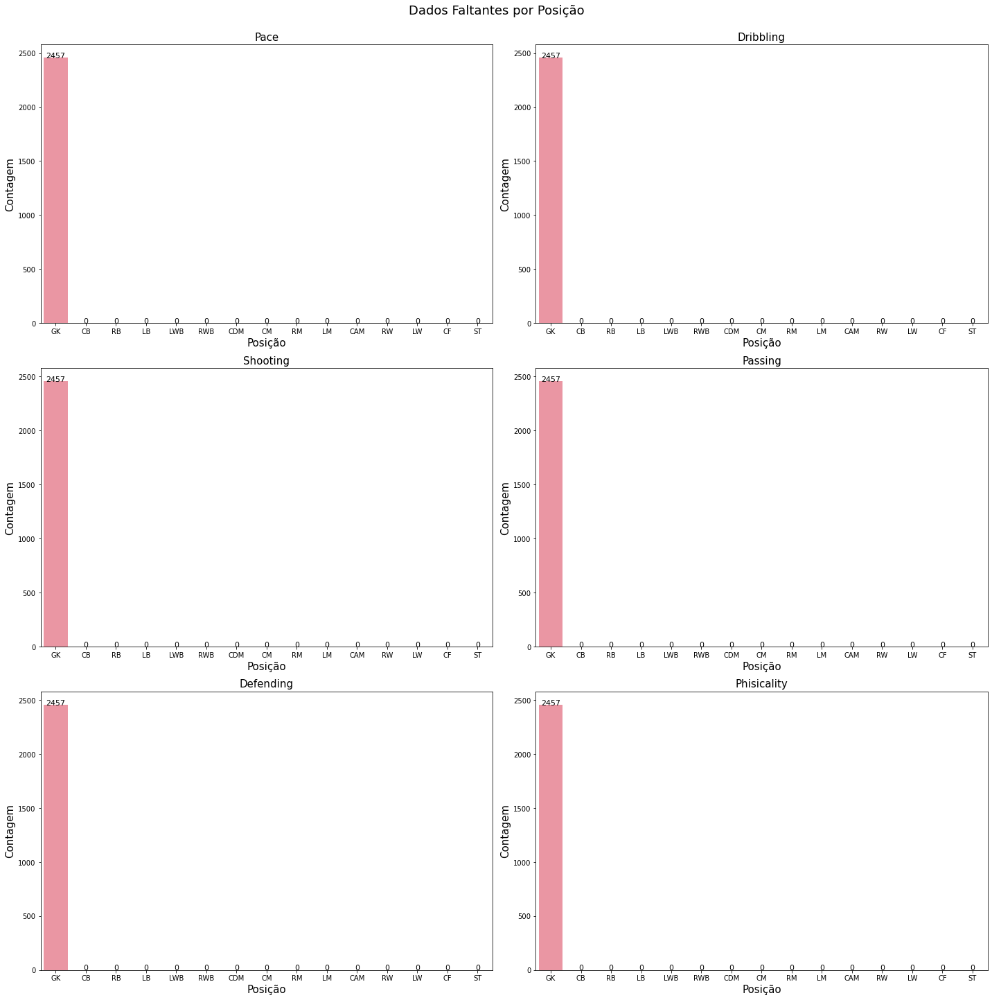

In [17]:
data0 = df[df['pace'].isna()]
data1 = df[df['dribbling'].isna()]
data2 = df[df['shooting'].isna()]
data3 = df[df['passing'].isna()]
data4 = df[df['defending'].isna()]
data5 = df[df['physicality'].isna()]

position_order = ['GK','CB','RB','LB','LWB','RWB','CDM','CM','RM','LM','CAM','RW','LW','CF','ST']

fig, ax = plt.subplots(3,2,figsize = (20,20))
ax = ax.flatten()
sns.countplot(ax=ax[0],x = 'position', data=data0, order = position_order)
ax[0].set_title('Pace',fontsize = 15)
ax[0].set_xlabel('Posição', fontsize = 15)
ax[0].set_ylabel('Contagem', fontsize = 15)
for rect in ax[0].patches:
    if rect.get_height() > 0:  
        ax[0].text (rect.get_x() + rect.get_width()  / 2,
                    rect.get_height()+ 0.25,
                    int(rect.get_height()),
                    horizontalalignment='center', 
                    fontsize = 11)
    else:
        ax[0].text (rect.get_x() + rect.get_width()  / 2,
                    0.25,
                    0,
                    horizontalalignment='center', 
                    fontsize = 11)        

sns.countplot(ax=ax[1],x = 'position', data=data1, order = position_order)
ax[1].set_title('Dribbling',fontsize = 15)
ax[1].set_xlabel('Posição', fontsize = 15)
ax[1].set_ylabel('Contagem', fontsize = 15)
for rect in ax[1].patches:
    if rect.get_height() > 0:  
        ax[1].text (rect.get_x() + rect.get_width()  / 2,
                    rect.get_height()+ 0.25,
                    int(rect.get_height()),
                    horizontalalignment='center', 
                    fontsize = 11)
    else:
        ax[1].text (rect.get_x() + rect.get_width()  / 2,
                    0.25,
                    0,
                    horizontalalignment='center', 
                    fontsize = 11) 

sns.countplot(ax=ax[2],x = 'position', data=data2, order = position_order)
ax[2].set_title('Shooting',fontsize = 15)
ax[2].set_xlabel('Posição', fontsize = 15)
ax[2].set_ylabel('Contagem', fontsize = 15)
for rect in ax[2].patches:
    if rect.get_height() > 0:  
        ax[2].text (rect.get_x() + rect.get_width()  / 2,
                    rect.get_height()+ 0.25,
                    int(rect.get_height()),
                    horizontalalignment='center', 
                    fontsize = 11)
    else:
        ax[2].text (rect.get_x() + rect.get_width()  / 2,
                    0.25,
                    0,
                    horizontalalignment='center', 
                    fontsize = 11)        

sns.countplot(ax=ax[3],x = 'position', data=data3, order = position_order)
ax[3].set_title('Passing',fontsize = 15)
ax[3].set_xlabel('Posição', fontsize = 15)
ax[3].set_ylabel('Contagem', fontsize = 15)
for rect in ax[3].patches:
    if rect.get_height() > 0:  
        ax[3].text (rect.get_x() + rect.get_width()  / 2,
                    rect.get_height()+ 0.25,
                    int(rect.get_height()),
                    horizontalalignment='center', 
                    fontsize = 11)
    else:
        ax[3].text (rect.get_x() + rect.get_width()  / 2,
                    0.25,
                    0,
                    horizontalalignment='center', 
                    fontsize = 11)        

sns.countplot(ax=ax[4],x = 'position', data=data4, order = position_order)
ax[4].set_title('Defending',fontsize = 15)
ax[4].set_xlabel('Posição', fontsize = 15)
ax[4].set_ylabel('Contagem', fontsize = 15)
for rect in ax[4].patches:
    if rect.get_height() > 0:  
        ax[4].text (rect.get_x() + rect.get_width()  / 2,
                    rect.get_height()+ 0.25,
                    int(rect.get_height()),
                    horizontalalignment='center', 
                    fontsize = 11)
    else:
        ax[4].text (rect.get_x() + rect.get_width()  / 2,
                    0.25,
                    0,
                    horizontalalignment='center', 
                    fontsize = 11) 

sns.countplot(ax=ax[5],x = 'position', data=data5, order = position_order)
ax[5].set_title('Phisicality',fontsize = 15)
ax[5].set_xlabel('Posição', fontsize = 15)
ax[5].set_ylabel('Contagem', fontsize = 15)
for rect in ax[5].patches:
    if rect.get_height() > 0:  
        ax[5].text (rect.get_x() + rect.get_width()  / 2,
                    rect.get_height()+ 0.25,
                    int(rect.get_height()),
                    horizontalalignment='center', 
                    fontsize = 11)
    else:
        ax[5].text (rect.get_x() + rect.get_width()  / 2,
                    0.25,
                    0,
                    horizontalalignment='center', 
                    fontsize = 11)    
        
plt.suptitle("Dados Faltantes por Posição", fontsize=18,y=1.0) 
plt.tight_layout()
plt.show()

#### Remoção de Goleiros

In [18]:
df = df[df['position']!='GK']


Your selected dataframe has 45 columns and 21397 Rows.
There are 32 columns that have missing values.


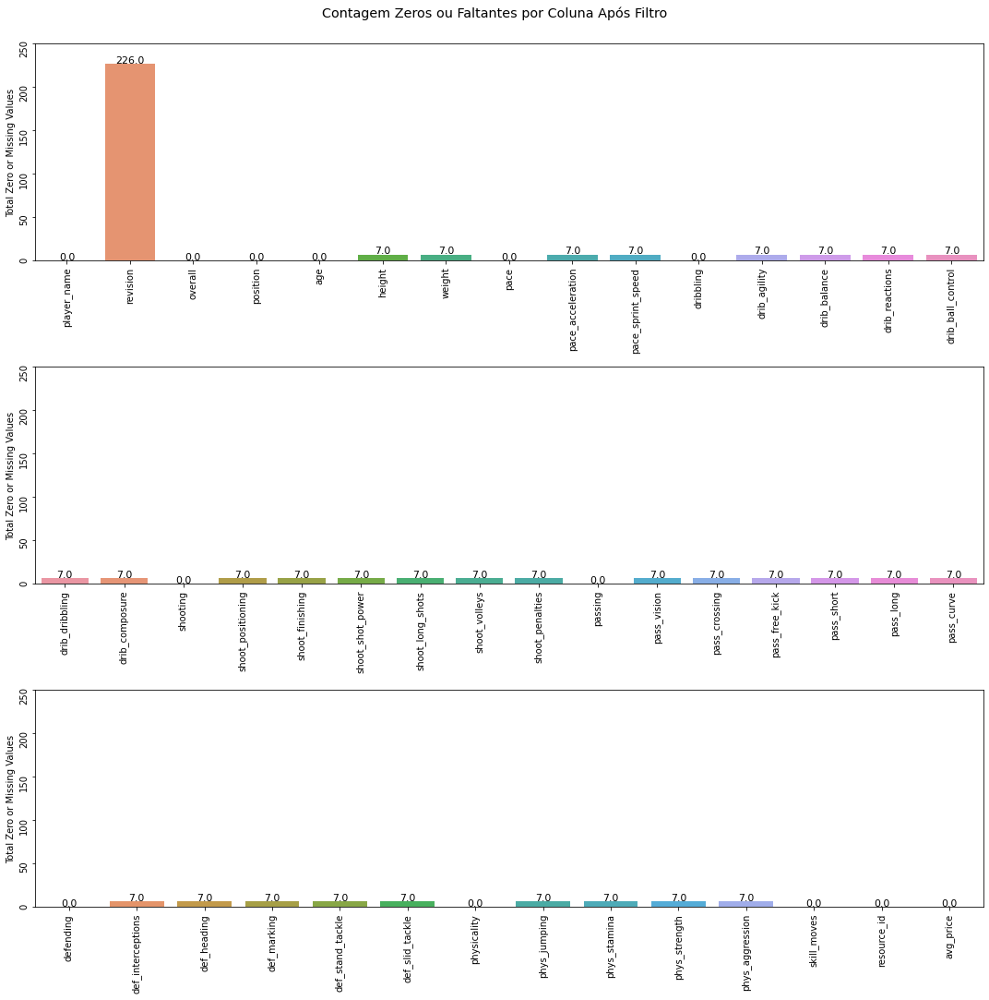

In [19]:
df_filtered = missing_zero_values_table(df)
n_part = len(df_filtered)
part_1 = df_filtered[0:15]
part_2 = df_filtered[15:31]
part_3 = df_filtered[31:45]

fig, ax = plt.subplots(3,1,figsize = (15,15))

sns.barplot(ax=ax[0],x=part_1.index, y='Total Zero or Missing Values',data=part_1)
sns.barplot(ax=ax[1],x=part_2.index, y='Total Zero or Missing Values',data=part_2)
sns.barplot(ax=ax[2],x=part_3.index, y='Total Zero or Missing Values',data=part_3)

for ax in fig.axes:
    ax.tick_params(labelrotation=90)
    ax.set(ylim=(0, 250))
    for rect in ax.patches:
        ax.text (rect.get_x() + rect.get_width()  / 2,
                    rect.get_height()+ 0.75,
                    rect.get_height(),
                    horizontalalignment='center', 
                    fontsize = 11)

plt.suptitle("Contagem Zeros ou Faltantes por Coluna Após Filtro", fontsize="x-large", y=1.0)   
plt.tight_layout()
plt.show()

#### Remoção 7 Registros sem Sub-Atributos

In [20]:
cols = ['height','pace_acceleration', 'pace_sprint_speed', 
        'drib_agility', 'drib_balance', 'drib_reactions', 'drib_ball_control', 'drib_dribbling',  
        'shoot_positioning', 'shoot_finishing', 'shoot_shot_power', 'shoot_long_shots', 'shoot_volleys', 'shoot_penalties', 
        'pass_vision', 'pass_crossing', 'pass_free_kick', 'pass_short', 'pass_long', 'pass_curve', 
        'def_interceptions', 'def_heading', 'def_marking', 'def_stand_tackle', 'def_slid_tackle', 
        'phys_jumping', 'phys_stamina', 'phys_strength', 'phys_aggression']

df.dropna(subset=cols, inplace = True)


#### Resumo do campo revision

In [21]:
df_rev = df[['revision','avg_price']].groupby('revision').agg(count=('avg_price','count'),
                                                     avg_price=('avg_price', 'mean')).sort_values(by='count',
                                                                                                    ascending=False)
df_rev['avg_price'] = df_rev['avg_price'].map('{:,.0f}'.format)
print(df_rev)

                      count  avg_price
revision                              
Normal                15924      1,521
non-rare               1286      1,140
Rare                    746      1,949
IF                      564     46,851
CL                      471     16,375
Sudamericana            469        827
Libertadores            433      1,256
Icon                    342  1,076,492
TOTS                    214    267,864
TOTW Moments            111     68,533
SIF                     104     87,227
MOTM                    101     29,973
TOTY Nominee             50    159,436
Europa MOTM              37     26,611
Libertadores KO Team     29     50,617
Future Stars             28    233,168
FUT Birthday             26    461,724
ShapeShifters            25    367,565
Headliners               24    341,348
OTW                      23     81,264
Hero                     22     27,666
Halloween                22    152,417
TIF                      20    204,595
UCL LIVE                 

#### Média dos itens Faltantes em Revision

In [22]:
df_rev_missing = df[df['revision'].isna()].mean()
df_rev_missing['avg_price'].mean()

1028.1083565811964

#### Agrupamento de revision em 2 categorias incluindo revision faltantes

In [23]:
df['type'] = pd.to_numeric(np.where((df['revision'] == 'Normal')|
                      (df['revision'] == 'Rare')|
                      (df['revision'] == 'non-rare')|
                      (df['revision'].isna()), '1', '2'))
df.drop(columns=['revision'], inplace=True)


#### Verificação de resource_id duplicados

In [24]:
df[df.duplicated(['resource_id'], keep=False)]

,player_name,overall,position,age,height,weight,pace,pace_acceleration,pace_sprint_speed,dribbling,drib_agility,drib_balance,drib_reactions,drib_ball_control,drib_dribbling,...,defending,def_interceptions,def_heading,def_marking,def_stand_tackle,def_slid_tackle,physicality,phys_jumping,phys_stamina,phys_strength,phys_aggression,skill_moves,resource_id,avg_price,type


#### Criação de campo Position numérico

In [25]:
df['position_n'] = pd.to_numeric(df['position'].replace(
    to_replace=['GK','CB','RB','LB','LWB','RWB','CDM','CM','RM','LM','CAM','RW','LW','CF','LF','RF','ST'], 
    value=[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]))

Your selected dataframe has 46 columns and 21390 Rows.
There are 0 columns that have missing values.


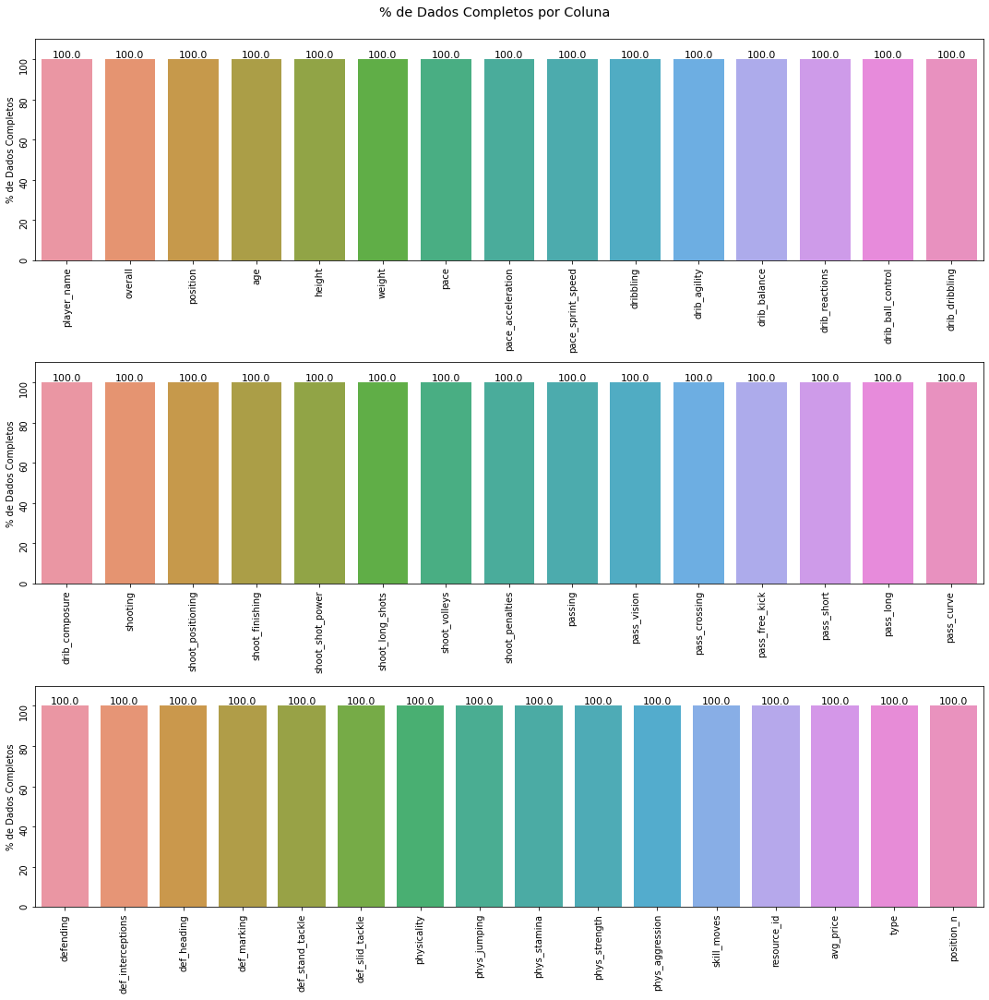

In [26]:
df_filtered = missing_zero_values_table(df)
df_filtered['% de Dados Completos'] = 100-df_filtered['% Total Zero or Missing Values'] 
n_part = len(df_filtered)
part_1 = df_filtered[0:15]
part_2 = df_filtered[15:30]
part_3 = df_filtered[30:46]

fig, ax = plt.subplots(3,1,figsize = (15,15))

sns.barplot(ax=ax[0],x=part_1.index, y='% de Dados Completos',data=part_1)
sns.barplot(ax=ax[1],x=part_2.index, y='% de Dados Completos',data=part_2)
sns.barplot(ax=ax[2],x=part_3.index, y='% de Dados Completos',data=part_3)

for ax in fig.axes:
    ax.tick_params(labelrotation=90)
    ax.set(ylim=(0, 110))
    for rect in ax.patches:
        ax.text (rect.get_x() + rect.get_width()  / 2,
                    rect.get_height()+ 0.75,
                    rect.get_height(),
                    horizontalalignment='center', 
                    fontsize = 11)

plt.suptitle("% de Dados Completos por Coluna", fontsize="x-large", y=1.0)   
plt.tight_layout()
plt.show()

## 4. Exploração dos Dados

#### Comparação dos maiores preços contr as maiores notas gerais

In [27]:
df.sort_values(by ='avg_price', ascending=False, inplace=True)
df_top15_price = df.nlargest(15, 'avg_price', keep='all')[['player_name','position','overall','avg_price','pace','dribbling','shooting','passing','defending','physicality']]
df_top15_price.reset_index(drop=True,inplace=True)
df_top15_ovr = df.nlargest(15, 'overall', keep='first')[['player_name','position','overall','avg_price','pace','dribbling','shooting','passing','defending','physicality']]
df_top15_ovr.reset_index(drop=True,inplace=True)

In [28]:
print('Top 15 Preços Médios\n')
df_top15_price[['player_name','position','overall','avg_price']]

Top 15 Preços Médios



,player_name,position,overall,avg_price
0,Ronaldo,ST,97,14507905.22
1,Gullit,CF,94,12701231.25
2,Eusébio,CF,94,11987726.12
3,Ronaldo,ST,96,10963113.33
4,Cruyff,CF,96,10282382.55
5,Ronaldinho,CAM,95,9757664.25
6,Zidane,CAM,97,8240270.22
7,Pelé,ST,99,8036227.50
8,Gullit,CF,93,7860148.59
9,Ronaldo,ST,94,7096794.03


In [29]:
print('Top 15 Notas Gerais\n')
df_top15_ovr[['player_name','position','overall','avg_price']]

Top 15 Notas Gerais



,player_name,position,overall,avg_price
0,Pelé,ST,99,8036227.50
1,Ronaldo,ST,99,6280118.80
2,Maradona,CAM,99,5157663.20
3,Messi,RW,99,3683822.28
4,Ronaldo,ST,99,3627947.22
5,Van Dijk,CB,99,2866874.94
6,Messi,RW,99,2493291.86
7,De Bruyne,CM,99,2368402.54
8,Van Dijk,CB,99,1981698.81
9,Lewandowski,ST,99,1357612.15


#### Análise do Log de Avg_Price


Registros: 21,390 | Média: $28,339 | Mediana: $864 | Moda: $200


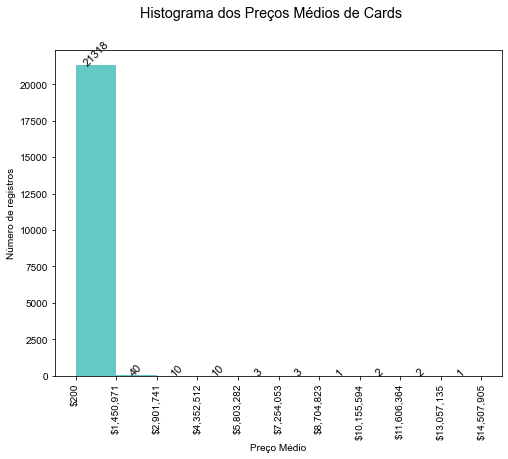

In [30]:
fig, ax = plt.subplots(figsize=(8, 6))
n, bins, edges = ax.hist(df['avg_price'],color = 'lightseagreen',alpha=0.7)
for ax in fig.axes:
    ax.tick_params(labelrotation=0)
    for rect in ax.patches:
        ax.text (rect.get_x() + rect.get_width()  / 2,
                    rect.get_height()+ 0.75,
                    str('{:1.0f}'.format(rect.get_height())),
                    rotation=45, 
                    horizontalalignment='center', 
                    fontsize = 11)
ax.xaxis.set_major_formatter('${x:1,.0f}')
plt.xticks(rotation=90)
plt.xticks(bins)
plt.ylabel('Número de registros')
plt.xlabel('Preço Médio')
plt.suptitle('Histograma dos Preços Médios de Cards', fontsize='x-large')   
sns.set()
print('\nRegistros: '+str('{:1,.0f}'.format(df['avg_price'].count()))+
      ' | Média: '+str('${:1,.0f}'.format(df['avg_price'].mean()))+
      ' | Mediana: '+str('${:1,.0f}'.format(df['avg_price'].median()))+
      ' | Moda: '+str('${:1,.0f}'.format(df['avg_price'].mode().iloc[0])))
plt.show()

In [31]:
df['log_avg_price'] = np.log(df['avg_price'])

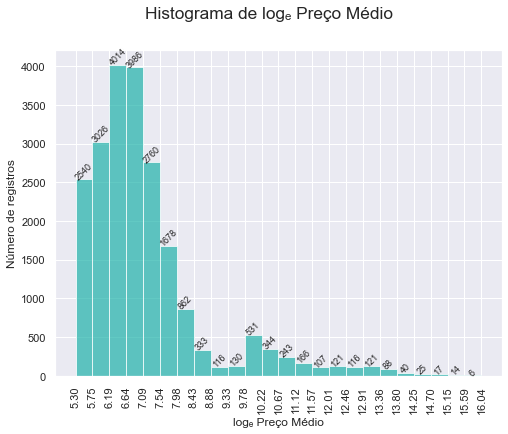

In [32]:

fig, ax = plt.subplots(figsize=(8, 6))
w = 25
n = (df['log_avg_price'].max() - df['log_avg_price'].min())/w
binned = np.arange(df['log_avg_price'].min(), df['log_avg_price'].max(), n)

ax.hist(df['log_avg_price'], bins=binned, color = 'lightseagreen',alpha=0.7)
ax.tick_params(labelrotation=0)
for rect in ax.patches:
    ax.text (rect.get_x() + rect.get_width()  / 2,
                rect.get_height()+ 0.75,
                str('{:1.0f}'.format(rect.get_height())),
                horizontalalignment='center', 
                rotation=45, 
                fontsize = 9)

plt.xticks(binned, rotation=90)
plt.ylabel("Número de registros")
plt.xlabel("log\u2091 Preço Médio")
plt.suptitle("Histograma de log\u2091 Preço Médio ", fontsize="x-large")  
sns.set()
plt.show()

#### Média de preço por posição e nota geral

In [33]:
interval_range = pd.interval_range(start=45, freq=5, end=100, closed='left')
df['bin'] = pd.cut(df['overall'], bins=interval_range)

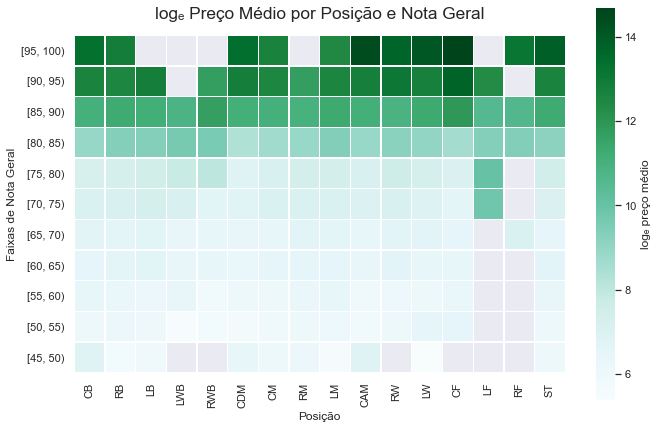

In [34]:
df_heat = df[['position_n','bin','log_avg_price']].groupby(['position_n','bin']).mean()
df_heat = df_heat.unstack(level=0)
fig, ax = plt.subplots(figsize=(11, 9))
sns.set_style("whitegrid")
sns.heatmap(df_heat, cmap="BuGn",
           square = True, 
           linewidth=0.3, cbar_kws={"shrink": .8,'label': 'log\u2091 preço médio'})
plt.yticks(rotation=0)
ax.set_xticklabels(['CB','RB','LB','LWB','RWB','CDM','CM','RM','LM','CAM','RW','LW','CF','LF','RF','ST'])
plt.gca().invert_yaxis()
plt.ylabel('Faixas de Nota Geral')
plt.xlabel('Posição')
plt.title("log\u2091 Preço Médio por Posição e Nota Geral", fontsize="x-large" ,y=1.03) 
plt.show()


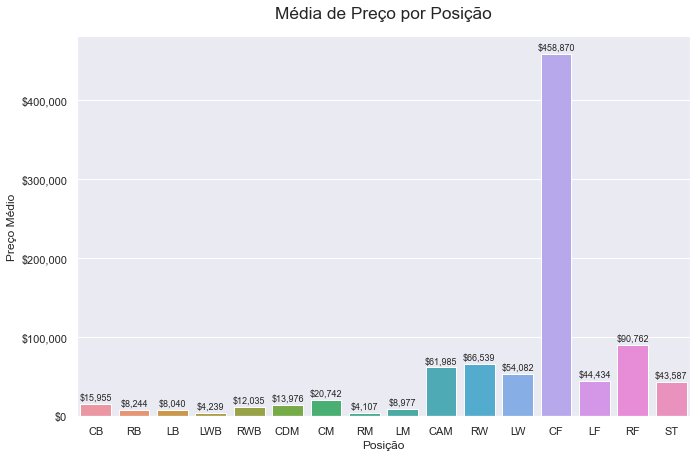

In [35]:
sns.set()
fig, ax = plt.subplots(figsize=(11, 7))
sns.barplot(x = df['position_n'],
            y = df['avg_price'],
            data = df,
            ci = None)
for rect in ax.patches:
    ax.text (rect.get_x() + rect.get_width()  / 2,
                rect.get_height()+ 5000,
                str('${:1,.0f}'.format(rect.get_height())),
                horizontalalignment='center', 
                rotation=0, 
                fontsize = 9)
ax.set_xticklabels(['CB','RB','LB','LWB','RWB','CDM','CM','RM','LM','CAM','RW','LW','CF','LF','RF','ST'])
ax.yaxis.set_major_formatter('${x:1,.0f}')
plt.ylabel('Preço Médio')
plt.xlabel('Posição')
plt.title('Média de Preço por Posição', fontsize="x-large" ,y=1.03) 
plt.show()




#### Verificação dos preços da posição CF


Registros: 204 | Média: $458,870 | Mediana: $1,655 | Moda: $200


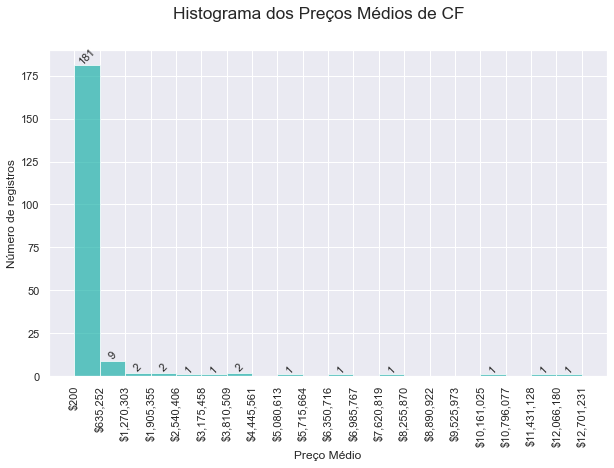

In [36]:
df_cf = df[df['position']=='CF']
sns.set()
fig, ax = plt.subplots(figsize=(10, 6))
n, bins, edges = ax.hist(df_cf['avg_price'],bins=20,color = 'lightseagreen',alpha=0.7)
for ax in fig.axes:
    ax.tick_params(labelrotation=0)
    for rect in ax.patches:
        if rect.get_height() > 0:    
            ax.text (rect.get_x() + rect.get_width()  / 2,
                        rect.get_height()+ 0.75,
                        str('{:1.0f}'.format(rect.get_height())),
                        rotation=45, 
                        horizontalalignment='center', 
                        fontsize = 11)
        else:
            ax.text (rect.get_x() + rect.get_width()  / 2,
                        rect.get_height()+ 0.75,
                        '',
                        rotation=45, 
                        horizontalalignment='center', 
                        fontsize = 11)      
        
ax.xaxis.set_major_formatter('${x:1,.0f}')
plt.xticks(rotation=90)
plt.xticks(bins)
plt.ylabel('Número de registros')
plt.xlabel('Preço Médio')
plt.suptitle('Histograma dos Preços Médios de CF', fontsize='x-large')   
sns.set()
print('\nRegistros: '+str('{:1,.0f}'.format(df_cf['avg_price'].count()))+
      ' | Média: '+str('${:1,.0f}'.format(df_cf['avg_price'].mean()))+
      ' | Mediana: '+str('${:1,.0f}'.format(df_cf['avg_price'].median()))+
      ' | Moda: '+str('${:1,.0f}'.format(df_cf['avg_price'].mode().iloc[0])))
plt.show()

In [37]:
df_cf.nlargest(100, 'avg_price', keep='all')[['player_name','position','overall','avg_price','pace','dribbling','shooting','passing','defending','physicality']]

,player_name,position,overall,avg_price,pace,dribbling,shooting,passing,defending,physicality
19588,Gullit,CF,94,12701231.25,90.00,91.00,95.00,93.00,83.00,91.00
19593,Eusébio,CF,94,11987726.12,97.00,95.00,99.00,87.00,46.00,80.00
19509,Cruyff,CF,96,10282382.55,93.00,98.00,96.00,93.00,43.00,77.00
12,Gullit,CF,93,7860148.59,86.00,89.00,91.00,91.00,82.00,90.00
268,Eusébio,CF,93,6757849.94,94.00,93.00,94.00,86.00,45.00,79.00
266,Cruyff,CF,94,5253705.66,91.00,94.00,92.00,91.00,42.00,73.00
289,Eusébio,CF,89,4087844.38,95.00,90.00,91.00,82.00,43.00,78.00
3,Pelé,CF,95,3890103.61,96.00,95.00,93.00,90.00,56.00,75.00
277,Eusébio,CF,91,3207795.57,93.00,90.00,93.00,88.00,42.00,74.00
278,Cruyff,CF,91,2758636.00,91.00,93.00,89.00,88.00,41.00,72.00


#### Spider dos 15 Melhores Cards

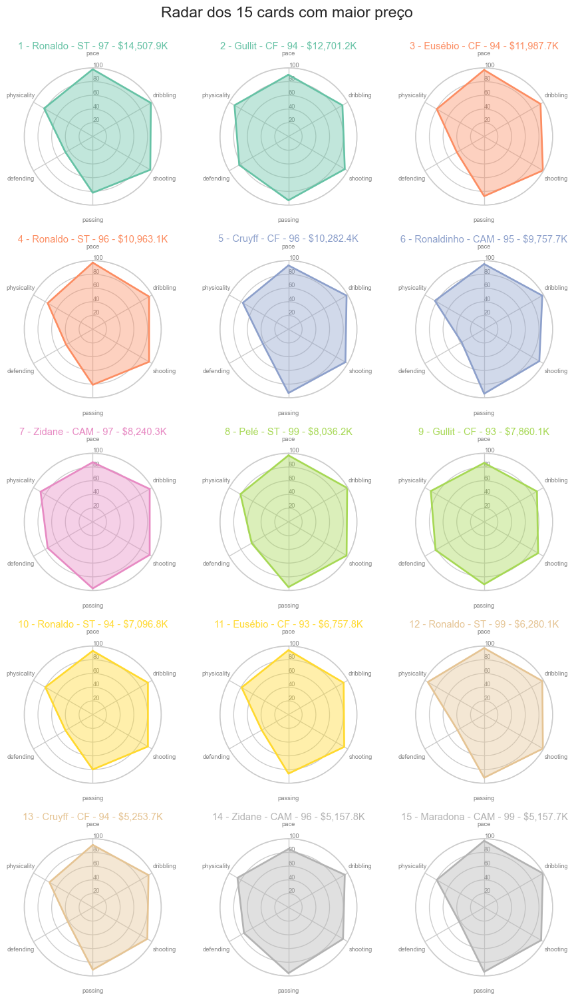

In [38]:
def make_spider( row, title, color):

    sns.set_style('whitegrid')
    
    # number of variable
    categories=list(df_top15_price)[4:]
    N = len(categories)

    # What will be the angle of each axis in the plot? (we divide the plot / number of variable)
    angles = [n / float(N) * 2 * pi for n in range(N)]
    angles += angles[:1]
   
    # Initialise the spider plot
    ax = plt.subplot(5,3,row+1, polar=True, )

    # If you want the first axis to be on top:
    ax.set_theta_offset(pi / 2)
    ax.set_theta_direction(-1)

    # Draw one axe per variable + add labels labels yet
    plt.xticks(angles[:-1], categories, color='grey', size=7)

    # Draw ylabels
    ax.set_rlabel_position(0)
    plt.yticks([20,40,60,80,100], ["20","40","60","80","100"], color="grey", size=7)
    plt.ylim(0,100)

    # Ind1
    values=df_top15_price.loc[row].drop(['player_name','position','overall','avg_price']).values.flatten().tolist()
    values += values[:1]
    ax.plot(angles, values, color=color, linewidth=2, linestyle='solid')
    ax.fill(angles, values, color=color, alpha=0.4)

    # Add a title
    plt.title(title, size=11, color=color, y=1.1)
        
my_dpi=96
plt.figure(figsize=(900/my_dpi, 1500/my_dpi), dpi=my_dpi)
 
# Create a color palette:
my_palette = plt.cm.get_cmap("Set2", len(df_top15_price.index))
 
# Loop to plot
for row in range(0, len(df_top15_price.index)):
    make_spider( row=row, title=str(row+1)+' - '
                +df_top15_price['player_name'][row]+' - '
                +df_top15_price['position'][row]+' - '
                +df_top15_price['overall'][row].astype(str)+' - '
                + '${:,.1f}K'.format(df_top15_price['avg_price'][row]/1000), color=my_palette(row))
    

plt.suptitle("Radar dos 15 cards com maior preço", fontsize="x-large", y=1.0)
plt.tight_layout()
plt.show()

#### Comparações do número de posições entre total e Top 100

In [39]:
df_1000 = df.nlargest(1000, 'overall')[['player_name','position','overall','pace','dribbling','shooting','passing','defending','physicality']]
df_500 = df.nlargest(500, 'overall')[['player_name','position','overall','pace','dribbling','shooting','passing','defending','physicality']]
df_100 = df.nlargest(100, 'overall')[['player_name','position','overall','pace','dribbling','shooting','passing','defending','physicality']]

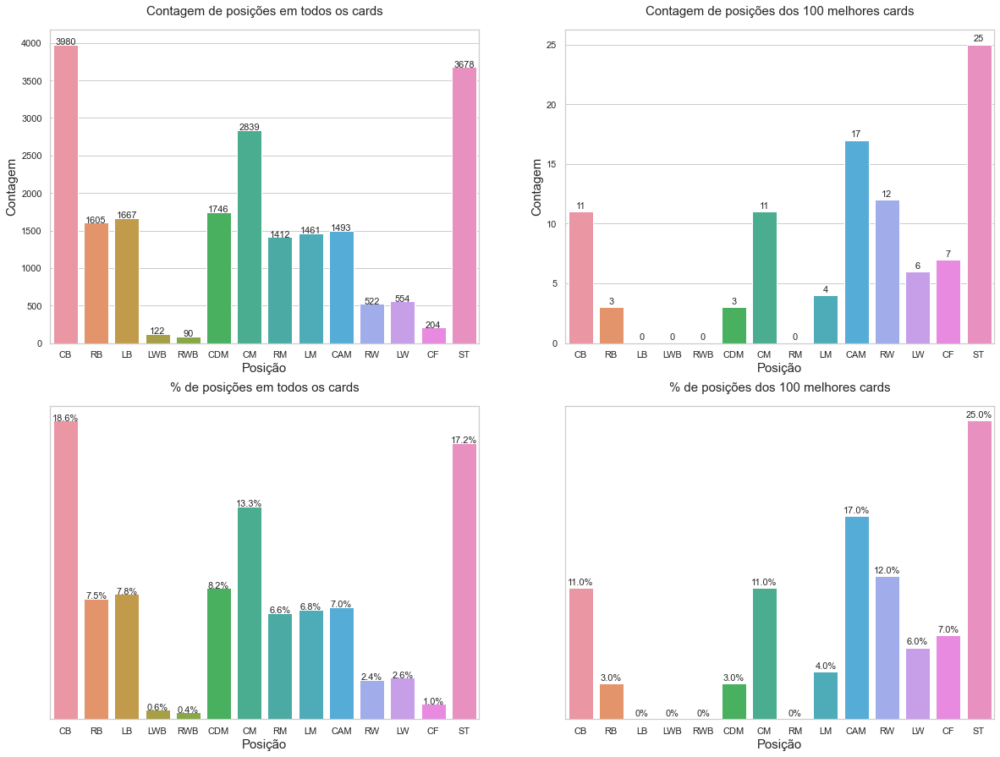

In [40]:
data = df_100
position_order = ['CB','RB','LB','LWB','RWB','CDM','CM','RM','LM','CAM','RW','LW','CF','ST']
total_0 = float(len(df))
total_1 = float(len(data))
sns.set_style('whitegrid')
fig, ax = plt.subplots(2,2,figsize = (20,15))
sns.countplot(ax=ax[0,0],x = 'position', data=df, order = position_order)
ax[0,0].set_title('Contagem de posições em todos os cards',fontsize = 15, y=1.03)
ax[0,0].set_xlabel('Posição', fontsize = 15)
ax[0,0].set_ylabel('Contagem', fontsize = 15)
for rect in ax[0,0].patches:
    if rect.get_height() > 0:     
        ax[0,0].text (rect.get_x() + rect.get_width()  / 2,
                    rect.get_height()+ 0.75,
                    int(rect.get_height()),
                    horizontalalignment='center', 
                    fontsize = 11)
    else:
        ax[0,0].text (rect.get_x() + rect.get_width()  / 2,
                    0.25,
                    0,
                    horizontalalignment='center', 
                    fontsize = 11)          

sns.countplot(ax=ax[0,1],x = 'position', data=data, order = position_order)
ax[0,1].set_title('Contagem de posições dos '+str(len(data))+' melhores cards',fontsize = 15, y=1.03)
ax[0,1].set_xlabel('Posição', fontsize = 15)
ax[0,1].set_ylabel('Contagem', fontsize = 15)
for rect in ax[0,1].patches:
    if rect.get_height() > 0:  
        ax[0,1].text (rect.get_x() + rect.get_width()  / 2,
                    rect.get_height()+ 0.25,
                    int(rect.get_height()),
                    horizontalalignment='center', 
                    fontsize = 11)
    else:
        ax[0,1].text (rect.get_x() + rect.get_width()  / 2,
                    0.25,
                    0,
                    horizontalalignment='center', 
                    fontsize = 11)    

sns.countplot(ax=ax[1,0],x = 'position', data=df, order = position_order)
ax[1,0].set_title('% de posições em todos os cards',fontsize = 15, y=1.03)
ax[1,0].set_xlabel('Posição', fontsize = 15)
ax[1,0].set_ylabel('')
ax[1,0].set_yticks([])
for rect in ax[1,0].patches:
        if rect.get_height() > 0:
            ax[1,0].text (rect.get_x() + rect.get_width()  / 2,
                        rect.get_height()+ 0.75,
                        str('{:1.1f}'.format(rect.get_height()/total_0*100))+'%',
                        horizontalalignment='center', 
                        fontsize = 11)
        else:
            ax[1,0].text (rect.get_x() + rect.get_width()  / 2,
                        0.25,
                        '0%',
                        horizontalalignment='center',
                        fontsize = 11)

sns.countplot(ax=ax[1,1],x = 'position', data=data, order = position_order)
ax[1,1].set_title('% de posições dos '+str(len(data))+' melhores cards',fontsize = 15, y=1.03)
ax[1,1].set_xlabel('Posição', fontsize = 15)
ax[1,1].set_ylabel('')
ax[1,1].set_yticks([])
for rect in ax[1,1].patches:
    if rect.get_height() > 0:    
        ax[1,1].text (rect.get_x() + rect.get_width()  / 2,
                    rect.get_height()+ 0.25,
                    str('{:1.1f}'.format(rect.get_height()/total_1*100))+'%',
                    horizontalalignment='center',
                    fontsize = 11)
    else:
        ax[1,1].text (rect.get_x() + rect.get_width()  / 2,
                    0.25,
                    '0%',
                    horizontalalignment='center',
                    fontsize = 11)
        
        
        


plt.show()

#### Correlação

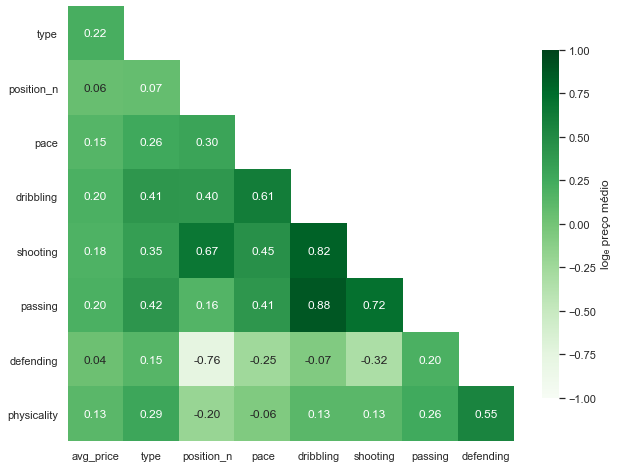

In [41]:
df_corr = df[['avg_price','type','position_n','pace', 'dribbling', 'shooting', 'passing', 'defending', 'physicality']].corr() # calculate correlation 
np.ones_like(df_corr, dtype=np.bool)
mask = np.triu(np.ones_like(df_corr, dtype=np.bool))

fig, ax = plt.subplots(figsize=(10, 8))
# mask
mask = np.triu(np.ones_like(df_corr, dtype=np.bool))
# adjust mask and df
mask = mask[1:, :-1]
corr = df_corr.iloc[1:,:-1].copy()
# plot heatmap
sns.heatmap(corr, 
           mask=mask, 
           annot=True, 
           fmt=".2f", 
           cmap='Greens',
           vmin=-1, 
           vmax=1,
           cbar_kws={"shrink": .8,'label': 'log\u2091 preço médio'})
# yticks
plt.yticks(rotation=0)
plt.show()

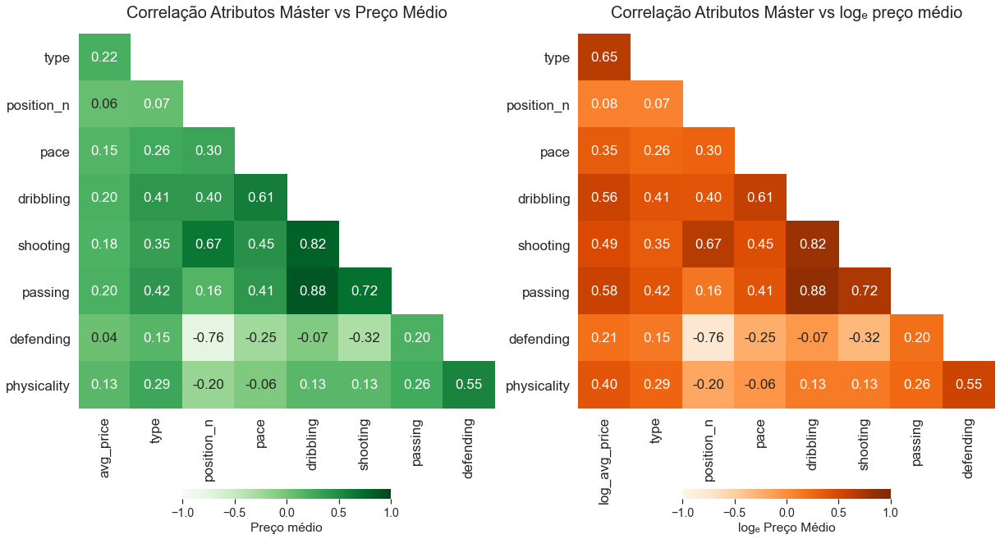

In [42]:
df_corr1 = df[['avg_price','type','position_n','pace', 'dribbling', 'shooting', 'passing', 'defending', 'physicality']].corr() # calculate correlation 
df_corr2 = df[['log_avg_price','type','position_n','pace', 'dribbling', 'shooting', 'passing', 'defending', 'physicality']].corr() # calculate correlation 

fig, ax = plt.subplots(1,2,figsize=(20, 12))
sns.set(font_scale=1.3)
sns.set_style('whitegrid')
# mask
mask1 = np.triu(np.ones_like(df_corr1, dtype=np.bool))
mask2 = np.triu(np.ones_like(df_corr2, dtype=np.bool))

# adjust mask and df
mask1 = mask1[1:, :-1]
mask2 = mask2[1:, :-1]
corr1 = df_corr1.iloc[1:,:-1].copy()
corr2 = df_corr2.iloc[1:,:-1].copy()

rotate_y=0
rotate_x=90

# plot heatmap
sns.heatmap(ax=ax[0],
           data=corr1, 
           mask=mask1, 
           annot=True, 
           annot_kws={"size": 17},
           fmt=".2f", 
           cmap='Greens',
           vmin=-1, 
           vmax=1,
           cbar_kws={"shrink": .5,'label': 'Preço médio','orientation': 'horizontal'})
ax[0].set_yticklabels(ax[0].get_yticklabels(), rotation=rotate_y,fontsize=17)
ax[0].set_xticklabels(ax[0].get_xticklabels(), rotation=rotate_x,fontsize=17)
ax[0].set_title('Correlação Atributos Máster vs Preço Médio',fontsize = 20, y=1.03)

sns.heatmap(ax=ax[1],
           data=corr2, 
           mask=mask2, 
           annot=True,
           annot_kws={"size": 17},
           fmt=".2f", 
           cmap='Oranges',
           vmin=-1, 
           vmax=1,
           cbar_kws={"shrink": .5,'label': 'log\u2091 Preço Médio','orientation': 'horizontal'} )
ax[1].set_yticklabels(ax[1].get_yticklabels(), rotation=rotate_y,fontsize=17)
ax[1].set_xticklabels(ax[1].get_xticklabels(), rotation=rotate_x,fontsize=17)
ax[1].set_title('Correlação Atributos Máster vs log\u2091 preço médio',fontsize = 20, y=1.03)

plt.show()

In [43]:
df_corr = df[['avg_price','type','position_n','age','weight','height','skill_moves','pace_acceleration', 'pace_sprint_speed', 'drib_agility', 'drib_balance', 'drib_reactions', 'drib_ball_control', 'drib_dribbling', 'drib_composure', 'shoot_positioning', 'shoot_finishing', 'shoot_shot_power', 'shoot_long_shots', 'shoot_volleys', 'shoot_penalties', 'pass_vision', 'pass_crossing', 'pass_free_kick', 'pass_short', 'pass_long', 'pass_curve', 'def_interceptions', 'def_heading', 'def_marking', 'def_stand_tackle', 'def_slid_tackle', 'phys_jumping', 'phys_stamina', 'phys_strength', 'phys_aggression']].corr() # calculate correlation 
sns.set_style('whitegrid')
fig, ax = plt.subplots(figsize=(20, 15), dpi=1000)
sns.set(font_scale=1)
sns.set_style('whitegrid')
# mask
mask = np.triu(np.ones_like(df_corr, dtype=np.bool))
# adjust mask and df
mask = mask[1:, :-1]
corr = df_corr.iloc[1:,:-1].copy()
# plot heatmap
sns.heatmap(corr, 
            mask=mask, 
            annot=True, 
            fmt=".2f", 
            cmap='Greens',
            vmin=-1, 
            vmax=1, 
            cbar_kws={"shrink": .2,'label': 'Preço médio','orientation': 'horizontal'})
# yticks
ax.set_title('Correlação Sub-atributos vs Preço Médio',fontsize = 20, y=1.03)
plt.yticks(rotation=0)
plt.show()

In [44]:
df_corr = df[['log_avg_price','type','position_n','age','weight','height','skill_moves','pace_acceleration', 'pace_sprint_speed', 'drib_agility', 'drib_balance', 'drib_reactions', 'drib_ball_control', 'drib_dribbling', 'drib_composure', 'shoot_positioning', 'shoot_finishing', 'shoot_shot_power', 'shoot_long_shots', 'shoot_volleys', 'shoot_penalties', 'pass_vision', 'pass_crossing', 'pass_free_kick', 'pass_short', 'pass_long', 'pass_curve', 'def_interceptions', 'def_heading', 'def_marking', 'def_stand_tackle', 'def_slid_tackle', 'phys_jumping', 'phys_stamina', 'phys_strength', 'phys_aggression']].corr() # calculate correlation 

fig, ax = plt.subplots(figsize=(20, 15), dpi = 1000)
sns.set(font_scale=1)
sns.set_style('whitegrid')
# mask
mask = np.triu(np.ones_like(df_corr, dtype=np.bool))
# adjust mask and df
mask = mask[1:, :-1]
corr = df_corr.iloc[1:,:-1].copy()
# plot heatmap
sns.heatmap(corr, 
            mask=mask, 
            annot=True, 
            fmt=".2f", 
            cmap='Oranges',
            vmin=-1, 
            vmax=1, 
            cbar_kws={"shrink": .2,'label': 'log\u2091 preço médio','orientation': 'horizontal'} )
# yticks
ax.set_title('Correlação Sub-atributos vs log\u2091 Preço Médio',fontsize = 20, y=1.03)
plt.yticks(rotation=0)
plt.show()

## Modelos de Regressão
#### Definição de Métricas e criação do dataframe para armazenar resultados

In [45]:
def store_metrics(actual, pred, name, alg, features, target):
    train_score = model.score(x_train, y_train)
    test_score = model.score(x_test, y_test)

    metrics = []
    metrics.append(name)
    metrics.append(alg)
    metrics.append(features)
    metrics.append(target)
    metrics.append(train_score)
    metrics.append(test_score)
    return metrics


def show_metrics(actual, pred):
    train_score = model.score(x_train, y_train)
    test_score = model.score(x_test, y_test)
    rmse = np.sqrt(mean_squared_error(actual, pred))
    mae = mean_absolute_error(actual, pred)
    mse = mean_squared_error(actual, pred)
    score = r2_score(actual, pred)

    return print ('r2_score:', score, '\n','mae:', mae, '\n','mse:', mse, '\n','rmse:', rmse)

In [46]:
df_results = pd.DataFrame([[np.nan,np.nan,np.nan,np.nan,np.nan,np.nan]], 
                  columns = ['Name' , 'Alg', 'Features','Target','Train_score', 'Test_score'])
df_results.dropna(inplace = True)
df_results

,Name,Alg,Features,Target,Train_score,Test_score


### Master avg_price
#### Divisão dos dados em training e test

In [47]:
x = df[['position_n','type','pace','dribbling','shooting','passing','defending','physicality']]
y = df['avg_price']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.33, random_state=25)

#### Regressão Linear

In [48]:
from sklearn.linear_model import LinearRegression
name = 'LR - Master - Avg_price'
alg = 'LR'
features = 'Master'
target = 'avg_price'
model = LinearRegression().fit(x_train, y_train)
y_pred = model.predict(x_test)
print('Train Score: '+ str(model.score(x_train, y_train)))
print('Test Score: '+ str(model.score(x_test, y_test)))
indexNames = df_results[df_results['Name'] == name ].index
df_results.drop(indexNames , inplace=True)
df_results.reset_index(drop=True, inplace=True)
show_metrics(y_test, y_pred)
df_results.loc[len(df_results)] = store_metrics(y_test, y_pred, name, alg, features, target)
df_results

Train Score: 0.08068173471138396
Test Score: 0.05973105138206991
r2_score: 0.05973105138206991 
 mae: 65076.189395145055 
 mse: 153942331681.73816 
 rmse: 392354.8542859361


,Name,Alg,Features,Target,Train_score,Test_score
0,LR - Master - Avg_price,LR,Master,avg_price,0.08,0.06


#### Gradient Boosting

In [49]:
from sklearn.ensemble import GradientBoostingRegressor
name = 'GB - Master - Avg_price'
alg = 'GB'
features = 'Master'
target = 'avg_price'
model = GradientBoostingRegressor(random_state=0).fit(x_train, y_train)
y_pred = model.predict(x_test)
print('Train Score: '+ str(model.score(x_train, y_train)))
print('Test Score: '+ str(model.score(x_test, y_test)))
indexNames = df_results[df_results['Name'] == name ].index
df_results.drop(indexNames , inplace=True)
df_results.reset_index(drop=True, inplace=True)
show_metrics(y_test, y_pred)
df_results.loc[len(df_results)] = store_metrics(y_test, y_pred, name, alg, features, target)
df_results

Train Score: 0.8395869210054551
Test Score: 0.330066627696457
r2_score: 0.330066627696457 
 mae: 30947.981126722632 
 mse: 109682560032.85693 
 rmse: 331183.5745215287


,Name,Alg,Features,Target,Train_score,Test_score
0,LR - Master - Avg_price,LR,Master,avg_price,0.08,0.06
1,GB - Master - Avg_price,GB,Master,avg_price,0.84,0.33


#### Random Forest

In [50]:
from sklearn.ensemble import RandomForestRegressor
name = 'RF - Master - Avg_price'
alg = 'RF'
features = 'Master'
target = 'avg_price'
model = RandomForestRegressor(random_state=0).fit(x_train, y_train)
y_pred = model.predict(x_test)
print('Train Score: '+ str(model.score(x_train, y_train)))
print('Test Score: '+ str(model.score(x_test, y_test)))
indexNames = df_results[df_results['Name'] == name ].index
df_results.drop(indexNames , inplace=True)
df_results.reset_index(drop=True, inplace=True)
show_metrics(y_test, y_pred)
df_results.loc[len(df_results)] = store_metrics(y_test, y_pred, name, alg, features, target)
df_results

Train Score: 0.9011566685554887
Test Score: 0.3642328806402242
r2_score: 0.3642328806402242 
 mae: 29079.14780606447 
 mse: 104088806617.17462 
 rmse: 322627.9693659163


,Name,Alg,Features,Target,Train_score,Test_score
0,LR - Master - Avg_price,LR,Master,avg_price,0.08,0.06
1,GB - Master - Avg_price,GB,Master,avg_price,0.84,0.33
2,RF - Master - Avg_price,RF,Master,avg_price,0.90,0.36


### Master log_avg_price
#### Divisão dos dados em training e test

In [51]:
x = df[['position_n','type','pace','dribbling','shooting','passing','defending','physicality']]
y = df['log_avg_price']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.33, random_state=25)

#### Regressão Linear

In [52]:
from sklearn.linear_model import LinearRegression
name = 'LR - Master - log_avg_price'
alg = 'LR'
features = 'Master'
target = 'log_avg_price'
model = LinearRegression().fit(x_train, y_train)
y_pred = model.predict(x_test)
print('Train Score: '+ str(model.score(x_train, y_train)))
print('Test Score: '+ str(model.score(x_test, y_test)))
indexNames = df_results[df_results['Name'] == name ].index
df_results.drop(indexNames , inplace=True)
df_results.reset_index(drop=True, inplace=True)
show_metrics(y_test, y_pred)
df_results.loc[len(df_results)] = store_metrics(y_test, y_pred, name, alg, features, target)
df_results

Train Score: 0.5831517079717459
Test Score: 0.6094034121962056
r2_score: 0.6094034121962056 
 mae: 0.7767094907986744 
 mse: 1.0615338543913002 
 rmse: 1.030307650360464


,Name,Alg,Features,Target,Train_score,Test_score
0,LR - Master - Avg_price,LR,Master,avg_price,0.08,0.06
1,GB - Master - Avg_price,GB,Master,avg_price,0.84,0.33
2,RF - Master - Avg_price,RF,Master,avg_price,0.90,0.36
3,LR - Master - log_avg_price,LR,Master,log_avg_price,0.58,0.61


#### Gradient Boosting

In [53]:
from sklearn.ensemble import GradientBoostingRegressor
name = 'GB - Master - log_avg_price'
alg = 'GB'
features = 'Master'
target = 'log_avg_price'
model = GradientBoostingRegressor(random_state=0).fit(x_train, y_train)
y_pred = model.predict(x_test)
print('Train Score: '+ str(model.score(x_train, y_train)))
print('Test Score: '+ str(model.score(x_test, y_test)))
indexNames = df_results[df_results['Name'] == name ].index
df_results.drop(indexNames , inplace=True)
df_results.reset_index(drop=True, inplace=True)
show_metrics(y_test, y_pred)
df_results.loc[len(df_results)] = store_metrics(y_test, y_pred, name, alg, features, target)
df_results

Train Score: 0.7802087457653822
Test Score: 0.795354695366301
r2_score: 0.795354695366301 
 mae: 0.5992573631382064 
 mse: 0.5561695257819709 
 rmse: 0.7457677425190572


,Name,Alg,Features,Target,Train_score,Test_score
0,LR - Master - Avg_price,LR,Master,avg_price,0.08,0.06
1,GB - Master - Avg_price,GB,Master,avg_price,0.84,0.33
2,RF - Master - Avg_price,RF,Master,avg_price,0.90,0.36
3,LR - Master - log_avg_price,LR,Master,log_avg_price,0.58,0.61
4,GB - Master - log_avg_price,GB,Master,log_avg_price,0.78,0.80


#### Random Forest

In [54]:
from sklearn.ensemble import RandomForestRegressor
name = 'RF - Master - log_avg_price'
alg = 'RF'
features = 'Master'
target = 'log_avg_price'
model = RandomForestRegressor(random_state=0).fit(x_train, y_train)
y_pred = model.predict(x_test)
print('Train Score: '+ str(model.score(x_train, y_train)))
print('Test Score: '+ str(model.score(x_test, y_test)))
indexNames = df_results[df_results['Name'] == name ].index
df_results.drop(indexNames , inplace=True)
df_results.reset_index(drop=True, inplace=True)
show_metrics(y_test, y_pred)
df_results.loc[len(df_results)] = store_metrics(y_test, y_pred, name, alg, features, target)
df_results

Train Score: 0.9517146555846656
Test Score: 0.7892964185070817
r2_score: 0.7892964185070817 
 mae: 0.6079887122710709 
 mse: 0.5726342522699739 
 rmse: 0.7567260087178013


,Name,Alg,Features,Target,Train_score,Test_score
0,LR - Master - Avg_price,LR,Master,avg_price,0.08,0.06
1,GB - Master - Avg_price,GB,Master,avg_price,0.84,0.33
2,RF - Master - Avg_price,RF,Master,avg_price,0.90,0.36
3,LR - Master - log_avg_price,LR,Master,log_avg_price,0.58,0.61
4,GB - Master - log_avg_price,GB,Master,log_avg_price,0.78,0.80
5,RF - Master - log_avg_price,RF,Master,log_avg_price,0.95,0.79


### Sub avg_price
#### Divisão dos dados em training e test

In [55]:
x = df[['position_n','type','age','height','weight','skill_moves','pace_acceleration', 'pace_sprint_speed', 
        'drib_agility', 'drib_balance', 'drib_reactions', 'drib_ball_control', 'drib_dribbling', 'drib_composure', 
        'shoot_positioning', 'shoot_finishing', 'shoot_shot_power', 'shoot_long_shots', 'shoot_volleys', 'shoot_penalties', 
        'pass_vision', 'pass_crossing', 'pass_free_kick', 'pass_short', 'pass_long', 'pass_curve', 'def_interceptions', 
        'def_heading', 'def_marking', 'def_stand_tackle', 'def_slid_tackle', 'phys_jumping', 'phys_stamina', 'phys_strength', 
        'phys_aggression']]
y = df['avg_price']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.33, random_state=25)

#### Regressão Linear

In [56]:
from sklearn.linear_model import LinearRegression
name = 'LR - Sub - avg_price'
alg = 'LR'
features = 'Sub'
target = 'avg_price'
model = LinearRegression().fit(x_train, y_train)
y_pred = model.predict(x_test)
print('Train Score: '+ str(model.score(x_train, y_train)))
print('Test Score: '+ str(model.score(x_test, y_test)))
indexNames = df_results[df_results['Name'] == name ].index
df_results.drop(indexNames , inplace=True)
df_results.reset_index(drop=True, inplace=True)
show_metrics(y_test, y_pred)
df_results.loc[len(df_results)] = store_metrics(y_test, y_pred, name, alg, features, target)
df_results

Train Score: 0.1711885516126178
Test Score: 0.13946536260028397
r2_score: 0.13946536260028397 
 mae: 77072.57767151343 
 mse: 140888103099.5744 
 rmse: 375350.64020136476


,Name,Alg,Features,Target,Train_score,Test_score
0,LR - Master - Avg_price,LR,Master,avg_price,0.08,0.06
1,GB - Master - Avg_price,GB,Master,avg_price,0.84,0.33
2,RF - Master - Avg_price,RF,Master,avg_price,0.90,0.36
3,LR - Master - log_avg_price,LR,Master,log_avg_price,0.58,0.61
4,GB - Master - log_avg_price,GB,Master,log_avg_price,0.78,0.80
5,RF - Master - log_avg_price,RF,Master,log_avg_price,0.95,0.79
6,LR - Sub - avg_price,LR,Sub,avg_price,0.17,0.14


#### Gradient Boosting

In [57]:
from sklearn.ensemble import GradientBoostingRegressor
name = 'GB - Sub - avg_price'
alg = 'GB'
features = 'Sub'
target = 'avg_price'
model = GradientBoostingRegressor(random_state=0).fit(x_train, y_train)
y_pred = model.predict(x_test)
print('Train Score: '+ str(model.score(x_train, y_train)))
print('Test Score: '+ str(model.score(x_test, y_test)))
indexNames = df_results[df_results['Name'] == name ].index
df_results.drop(indexNames , inplace=True)
df_results.reset_index(drop=True, inplace=True)
show_metrics(y_test, y_pred)
df_results.loc[len(df_results)] = store_metrics(y_test, y_pred, name, alg, features, target)
df_results

Train Score: 0.9754434335564361
Test Score: 0.6559192956809731
r2_score: 0.6559192956809731 
 mae: 21699.029518392483 
 mse: 56333441604.577576 
 rmse: 237346.66967239624


,Name,Alg,Features,Target,Train_score,Test_score
0,LR - Master - Avg_price,LR,Master,avg_price,0.08,0.06
1,GB - Master - Avg_price,GB,Master,avg_price,0.84,0.33
2,RF - Master - Avg_price,RF,Master,avg_price,0.90,0.36
3,LR - Master - log_avg_price,LR,Master,log_avg_price,0.58,0.61
4,GB - Master - log_avg_price,GB,Master,log_avg_price,0.78,0.80
5,RF - Master - log_avg_price,RF,Master,log_avg_price,0.95,0.79
6,LR - Sub - avg_price,LR,Sub,avg_price,0.17,0.14
7,GB - Sub - avg_price,GB,Sub,avg_price,0.98,0.66


#### Random Forest

In [58]:
from sklearn.ensemble import RandomForestRegressor
name = 'RF - Sub - avg_price'
alg = 'RF'
features = 'Sub'
target = 'avg_price'
model = RandomForestRegressor(random_state=0).fit(x_train, y_train)
y_pred = model.predict(x_test)
print('Train Score: '+ str(model.score(x_train, y_train)))
print('Test Score: '+ str(model.score(x_test, y_test)))
indexNames = df_results[df_results['Name'] == name ].index
df_results.drop(indexNames , inplace=True)
df_results.reset_index(drop=True, inplace=True)
show_metrics(y_test, y_pred)
df_results.loc[len(df_results)] = store_metrics(y_test, y_pred, name, alg, features, target)
df_results

Train Score: 0.9464635194790891
Test Score: 0.5961921768975131
r2_score: 0.5961921768975131 
 mae: 22660.390067425196 
 mse: 66112060736.55328 
 rmse: 257122.65698797003


,Name,Alg,Features,Target,Train_score,Test_score
0,LR - Master - Avg_price,LR,Master,avg_price,0.08,0.06
1,GB - Master - Avg_price,GB,Master,avg_price,0.84,0.33
2,RF - Master - Avg_price,RF,Master,avg_price,0.90,0.36
3,LR - Master - log_avg_price,LR,Master,log_avg_price,0.58,0.61
4,GB - Master - log_avg_price,GB,Master,log_avg_price,0.78,0.80
5,RF - Master - log_avg_price,RF,Master,log_avg_price,0.95,0.79
6,LR - Sub - avg_price,LR,Sub,avg_price,0.17,0.14
7,GB - Sub - avg_price,GB,Sub,avg_price,0.98,0.66
8,RF - Sub - avg_price,RF,Sub,avg_price,0.95,0.60


### Sub log_avg_price
#### Divisão dos dados em training e test

In [59]:
x = df[['position_n','type','age','height','weight','skill_moves','pace_acceleration', 'pace_sprint_speed', 
        'drib_agility', 'drib_balance', 'drib_reactions', 'drib_ball_control', 'drib_dribbling', 'drib_composure', 
        'shoot_positioning', 'shoot_finishing', 'shoot_shot_power', 'shoot_long_shots', 'shoot_volleys', 'shoot_penalties', 
        'pass_vision', 'pass_crossing', 'pass_free_kick', 'pass_short', 'pass_long', 'pass_curve', 'def_interceptions', 
        'def_heading', 'def_marking', 'def_stand_tackle', 'def_slid_tackle', 'phys_jumping', 'phys_stamina', 'phys_strength', 
        'phys_aggression']]
y = df['log_avg_price']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.33, random_state=25)

#### Regressão Linear

In [60]:
from sklearn.linear_model import LinearRegression
name = 'LR - Sub - log_avg_price'
alg = 'LR'
features = 'Sub'
target = 'log_avg_price'
model = LinearRegression().fit(x_train, y_train)
y_pred = model.predict(x_test)
print('Train Score: '+ str(model.score(x_train, y_train)))
print('Test Score: '+ str(model.score(x_test, y_test)))
indexNames = df_results[df_results['Name'] == name ].index
df_results.drop(indexNames , inplace=True)
df_results.reset_index(drop=True, inplace=True)
show_metrics(y_test, y_pred)
df_results.loc[len(df_results)] = store_metrics(y_test, y_pred, name, alg, features, target)
df_results

Train Score: 0.6478098590453463
Test Score: 0.6742292069668221
r2_score: 0.6742292069668221 
 mae: 0.73754629444296 
 mse: 0.8853552139844386 
 rmse: 0.9409331612736574


,Name,Alg,Features,Target,Train_score,Test_score
0,LR - Master - Avg_price,LR,Master,avg_price,0.08,0.06
1,GB - Master - Avg_price,GB,Master,avg_price,0.84,0.33
2,RF - Master - Avg_price,RF,Master,avg_price,0.90,0.36
3,LR - Master - log_avg_price,LR,Master,log_avg_price,0.58,0.61
4,GB - Master - log_avg_price,GB,Master,log_avg_price,0.78,0.80
5,RF - Master - log_avg_price,RF,Master,log_avg_price,0.95,0.79
6,LR - Sub - avg_price,LR,Sub,avg_price,0.17,0.14
7,GB - Sub - avg_price,GB,Sub,avg_price,0.98,0.66
8,RF - Sub - avg_price,RF,Sub,avg_price,0.95,0.60
9,LR - Sub - log_avg_price,LR,Sub,log_avg_price,0.65,0.67


#### Gradient Boosting

In [61]:
from sklearn.ensemble import GradientBoostingRegressor
name = 'GB - Sub - log_avg_price'
alg = 'GB'
features = 'Sub'
target = 'log_avg_price'
model = GradientBoostingRegressor(random_state=0).fit(x_train, y_train)
y_pred = model.predict(x_test)
print('Train Score: '+ str(model.score(x_train, y_train)))
print('Test Score: '+ str(model.score(x_test, y_test)))
indexNames = df_results[df_results['Name'] == name ].index
df_results.drop(indexNames , inplace=True)
df_results.reset_index(drop=True, inplace=True)
show_metrics(y_test, y_pred)
df_results.loc[len(df_results)] = store_metrics(y_test, y_pred, name, alg, features, target)
df_results

Train Score: 0.8001369840116609
Test Score: 0.8106877844184164
r2_score: 0.8106877844184164 
 mae: 0.579167085125494 
 mse: 0.5144984164342539 
 rmse: 0.7172854497578031


,Name,Alg,Features,Target,Train_score,Test_score
0,LR - Master - Avg_price,LR,Master,avg_price,0.08,0.06
1,GB - Master - Avg_price,GB,Master,avg_price,0.84,0.33
2,RF - Master - Avg_price,RF,Master,avg_price,0.90,0.36
3,LR - Master - log_avg_price,LR,Master,log_avg_price,0.58,0.61
4,GB - Master - log_avg_price,GB,Master,log_avg_price,0.78,0.80
5,RF - Master - log_avg_price,RF,Master,log_avg_price,0.95,0.79
6,LR - Sub - avg_price,LR,Sub,avg_price,0.17,0.14
7,GB - Sub - avg_price,GB,Sub,avg_price,0.98,0.66
8,RF - Sub - avg_price,RF,Sub,avg_price,0.95,0.60
9,LR - Sub - log_avg_price,LR,Sub,log_avg_price,0.65,0.67


#### Random Forest

In [62]:
from sklearn.ensemble import RandomForestRegressor
name = 'RF - Sub - log_avg_price'
alg = 'RF'
features = 'Sub'
target = 'log_avg_price'
model = RandomForestRegressor(random_state=0).fit(x_train, y_train)
y_pred = model.predict(x_test)
print('Train Score: '+ str(model.score(x_train, y_train)))
print('Test Score: '+ str(model.score(x_test, y_test)))
indexNames = df_results[df_results['Name'] == name ].index
df_results.drop(indexNames , inplace=True)
df_results.reset_index(drop=True, inplace=True)
show_metrics(y_test, y_pred)
df_results.loc[len(df_results)] = store_metrics(y_test, y_pred, name, alg, features, target)
df_results

Train Score: 0.9551360364295866
Test Score: 0.8104866401797431
r2_score: 0.8104866401797431 
 mae: 0.5780994571201904 
 mse: 0.5150450710278538 
 rmse: 0.717666406506431


,Name,Alg,Features,Target,Train_score,Test_score
0,LR - Master - Avg_price,LR,Master,avg_price,0.08,0.06
1,GB - Master - Avg_price,GB,Master,avg_price,0.84,0.33
2,RF - Master - Avg_price,RF,Master,avg_price,0.90,0.36
3,LR - Master - log_avg_price,LR,Master,log_avg_price,0.58,0.61
4,GB - Master - log_avg_price,GB,Master,log_avg_price,0.78,0.80
5,RF - Master - log_avg_price,RF,Master,log_avg_price,0.95,0.79
6,LR - Sub - avg_price,LR,Sub,avg_price,0.17,0.14
7,GB - Sub - avg_price,GB,Sub,avg_price,0.98,0.66
8,RF - Sub - avg_price,RF,Sub,avg_price,0.95,0.60
9,LR - Sub - log_avg_price,LR,Sub,log_avg_price,0.65,0.67


### All avg_price
#### Divisão dos dados em training e test

In [63]:
x = df[['position_n','type','pace','dribbling','shooting','passing','defending','physicality',
        'age','height','weight','skill_moves','pace_acceleration', 'pace_sprint_speed', 'drib_agility', 'drib_balance', 
        'drib_reactions', 'drib_ball_control', 'drib_dribbling', 'drib_composure', 'shoot_positioning', 'shoot_finishing', 
        'shoot_shot_power', 'shoot_long_shots', 'shoot_volleys', 'shoot_penalties', 'pass_vision', 'pass_crossing', 
        'pass_free_kick', 'pass_short', 'pass_long', 'pass_curve', 'def_interceptions', 'def_heading', 'def_marking', 
        'def_stand_tackle', 'def_slid_tackle', 'phys_jumping', 'phys_stamina', 'phys_strength', 'phys_aggression']]
y = df['avg_price']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.33, random_state=25)

#### Regressão Linear

In [64]:
from sklearn.linear_model import LinearRegression
name = 'LR - All - avg_price'
alg = 'LR'
features = 'All'
target = 'avg_price'
model = LinearRegression().fit(x_train, y_train)
y_pred = model.predict(x_test)
print('Train Score: '+ str(model.score(x_train, y_train)))
print('Test Score: '+ str(model.score(x_test, y_test)))
indexNames = df_results[df_results['Name'] == name ].index
df_results.drop(indexNames , inplace=True)
df_results.reset_index(drop=True, inplace=True)
show_metrics(y_test, y_pred)
df_results.loc[len(df_results)] = store_metrics(y_test, y_pred, name, alg, features, target)
df_results

Train Score: 0.17612131826560995
Test Score: 0.14122617129958204
r2_score: 0.14122617129958204 
 mae: 78311.8758408674 
 mse: 140599820691.42526 
 rmse: 374966.4260856234


,Name,Alg,Features,Target,Train_score,Test_score
0,LR - Master - Avg_price,LR,Master,avg_price,0.08,0.06
1,GB - Master - Avg_price,GB,Master,avg_price,0.84,0.33
2,RF - Master - Avg_price,RF,Master,avg_price,0.90,0.36
3,LR - Master - log_avg_price,LR,Master,log_avg_price,0.58,0.61
4,GB - Master - log_avg_price,GB,Master,log_avg_price,0.78,0.80
5,RF - Master - log_avg_price,RF,Master,log_avg_price,0.95,0.79
6,LR - Sub - avg_price,LR,Sub,avg_price,0.17,0.14
7,GB - Sub - avg_price,GB,Sub,avg_price,0.98,0.66
8,RF - Sub - avg_price,RF,Sub,avg_price,0.95,0.60
9,LR - Sub - log_avg_price,LR,Sub,log_avg_price,0.65,0.67


#### Gradient Boosting

In [65]:
from sklearn.ensemble import GradientBoostingRegressor
name = 'GB - All - avg_price'
alg = 'GB'
features = 'All'
target = 'avg_price'
model = GradientBoostingRegressor(random_state=0).fit(x_train, y_train)
y_pred = model.predict(x_test)
print('Train Score: '+ str(model.score(x_train, y_train)))
print('Test Score: '+ str(model.score(x_test, y_test)))
indexNames = df_results[df_results['Name'] == name ].index
df_results.drop(indexNames , inplace=True)
df_results.reset_index(drop=True, inplace=True)
show_metrics(y_test, y_pred)
df_results.loc[len(df_results)] = store_metrics(y_test, y_pred, name, alg, features, target)
df_results

Train Score: 0.9736872255080345
Test Score: 0.6412955968492291
r2_score: 0.6412955968492291 
 mae: 22174.812746829826 
 mse: 58727656897.21182 
 rmse: 242337.8981860077


,Name,Alg,Features,Target,Train_score,Test_score
0,LR - Master - Avg_price,LR,Master,avg_price,0.08,0.06
1,GB - Master - Avg_price,GB,Master,avg_price,0.84,0.33
2,RF - Master - Avg_price,RF,Master,avg_price,0.90,0.36
3,LR - Master - log_avg_price,LR,Master,log_avg_price,0.58,0.61
4,GB - Master - log_avg_price,GB,Master,log_avg_price,0.78,0.80
5,RF - Master - log_avg_price,RF,Master,log_avg_price,0.95,0.79
6,LR - Sub - avg_price,LR,Sub,avg_price,0.17,0.14
7,GB - Sub - avg_price,GB,Sub,avg_price,0.98,0.66
8,RF - Sub - avg_price,RF,Sub,avg_price,0.95,0.60
9,LR - Sub - log_avg_price,LR,Sub,log_avg_price,0.65,0.67


#### Random Forest

In [66]:
from sklearn.ensemble import RandomForestRegressor
name = 'RF - All - avg_price'
alg = 'RF'
features = 'All'
target = 'avg_price'
model = RandomForestRegressor(random_state=0).fit(x_train, y_train)
y_pred = model.predict(x_test)
print('Train Score: '+ str(model.score(x_train, y_train)))
print('Test Score: '+ str(model.score(x_test, y_test)))
indexNames = df_results[df_results['Name'] == name ].index
df_results.drop(indexNames , inplace=True)
df_results.reset_index(drop=True, inplace=True)
show_metrics(y_test, y_pred)
df_results.loc[len(df_results)] = store_metrics(y_test, y_pred, name, alg, features, target)
df_results

Train Score: 0.9463049285249953
Test Score: 0.5941559455379413
r2_score: 0.5941559455379413 
 mae: 22211.05368270484 
 mse: 66445435781.84933 
 rmse: 257770.12197275565


,Name,Alg,Features,Target,Train_score,Test_score
0,LR - Master - Avg_price,LR,Master,avg_price,0.08,0.06
1,GB - Master - Avg_price,GB,Master,avg_price,0.84,0.33
2,RF - Master - Avg_price,RF,Master,avg_price,0.90,0.36
3,LR - Master - log_avg_price,LR,Master,log_avg_price,0.58,0.61
4,GB - Master - log_avg_price,GB,Master,log_avg_price,0.78,0.80
5,RF - Master - log_avg_price,RF,Master,log_avg_price,0.95,0.79
6,LR - Sub - avg_price,LR,Sub,avg_price,0.17,0.14
7,GB - Sub - avg_price,GB,Sub,avg_price,0.98,0.66
8,RF - Sub - avg_price,RF,Sub,avg_price,0.95,0.60
9,LR - Sub - log_avg_price,LR,Sub,log_avg_price,0.65,0.67


### All log_avg_price
#### Divisão dos dados em training e test

In [67]:
x = df[['position_n','type','pace','dribbling','shooting','passing','defending','physicality',
        'age','height','weight','skill_moves','pace_acceleration', 'pace_sprint_speed', 'drib_agility', 'drib_balance', 
        'drib_reactions', 'drib_ball_control', 'drib_dribbling', 'drib_composure', 'shoot_positioning', 'shoot_finishing', 
        'shoot_shot_power', 'shoot_long_shots', 'shoot_volleys', 'shoot_penalties', 'pass_vision', 'pass_crossing', 
        'pass_free_kick', 'pass_short', 'pass_long', 'pass_curve', 'def_interceptions', 'def_heading', 'def_marking', 
        'def_stand_tackle', 'def_slid_tackle', 'phys_jumping', 'phys_stamina', 'phys_strength', 'phys_aggression']]
y = df['log_avg_price']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.33, random_state=25)

#### Regressão Linear

In [68]:
from sklearn.linear_model import LinearRegression
name = 'LR - All - log_avg_price'
alg = 'LR'
features = 'All'
target = 'log_avg_price'
model = LinearRegression().fit(x_train, y_train)
y_pred = model.predict(x_test)
print('Train Score: '+ str(model.score(x_train, y_train)))
print('Test Score: '+ str(model.score(x_test, y_test)))
indexNames = df_results[df_results['Name'] == name ].index
df_results.drop(indexNames , inplace=True)
df_results.reset_index(drop=True, inplace=True)
show_metrics(y_test, y_pred)
df_results.loc[len(df_results)] = store_metrics(y_test, y_pred, name, alg, features, target)
df_results

Train Score: 0.6558027279293397
Test Score: 0.6844059798124459
r2_score: 0.6844059798124459 
 mae: 0.7246503902693505 
 mse: 0.8576975507037076 
 rmse: 0.9261196200835546


,Name,Alg,Features,Target,Train_score,Test_score
0,LR - Master - Avg_price,LR,Master,avg_price,0.08,0.06
1,GB - Master - Avg_price,GB,Master,avg_price,0.84,0.33
2,RF - Master - Avg_price,RF,Master,avg_price,0.90,0.36
3,LR - Master - log_avg_price,LR,Master,log_avg_price,0.58,0.61
4,GB - Master - log_avg_price,GB,Master,log_avg_price,0.78,0.80
5,RF - Master - log_avg_price,RF,Master,log_avg_price,0.95,0.79
6,LR - Sub - avg_price,LR,Sub,avg_price,0.17,0.14
7,GB - Sub - avg_price,GB,Sub,avg_price,0.98,0.66
8,RF - Sub - avg_price,RF,Sub,avg_price,0.95,0.60
9,LR - Sub - log_avg_price,LR,Sub,log_avg_price,0.65,0.67


#### Gradient Boosting

In [69]:
from sklearn.ensemble import GradientBoostingRegressor
name = 'GB - All - log_avg_price'
alg = 'GB'
features = 'All'
target = 'log_avg_price'
model = GradientBoostingRegressor(random_state=0).fit(x_train, y_train)
y_pred = model.predict(x_test)
print('Train Score: '+ str(model.score(x_train, y_train)))
print('Test Score: '+ str(model.score(x_test, y_test)))
indexNames = df_results[df_results['Name'] == name ].index
df_results.drop(indexNames , inplace=True)
df_results.reset_index(drop=True, inplace=True)
show_metrics(y_test, y_pred)
df_results.loc[len(df_results)] = store_metrics(y_test, y_pred, name, alg, features, target)
df_results

Train Score: 0.8019095562496752
Test Score: 0.8122095629533835
r2_score: 0.8122095629533835 
 mae: 0.5761529502142215 
 mse: 0.5103626418673621 
 rmse: 0.714396697827868


,Name,Alg,Features,Target,Train_score,Test_score
0,LR - Master - Avg_price,LR,Master,avg_price,0.08,0.06
1,GB - Master - Avg_price,GB,Master,avg_price,0.84,0.33
2,RF - Master - Avg_price,RF,Master,avg_price,0.90,0.36
3,LR - Master - log_avg_price,LR,Master,log_avg_price,0.58,0.61
4,GB - Master - log_avg_price,GB,Master,log_avg_price,0.78,0.80
5,RF - Master - log_avg_price,RF,Master,log_avg_price,0.95,0.79
6,LR - Sub - avg_price,LR,Sub,avg_price,0.17,0.14
7,GB - Sub - avg_price,GB,Sub,avg_price,0.98,0.66
8,RF - Sub - avg_price,RF,Sub,avg_price,0.95,0.60
9,LR - Sub - log_avg_price,LR,Sub,log_avg_price,0.65,0.67


#### Random Forest

In [70]:
from sklearn.ensemble import RandomForestRegressor
name = 'RF - All - log_avg_price'
alg = 'RF'
features = 'All'
target = 'log_avg_price'
model = RandomForestRegressor(random_state=0).fit(x_train, y_train)
y_pred = model.predict(x_test)
print('Train Score: '+ str(model.score(x_train, y_train)))
print('Test Score: '+ str(model.score(x_test, y_test)))
indexNames = df_results[df_results['Name'] == name ].index
df_results.drop(indexNames , inplace=True)
df_results.reset_index(drop=True, inplace=True)
show_metrics(y_test, y_pred)
df_results.loc[len(df_results)] = store_metrics(y_test, y_pred, name, alg, features, target)
df_results

Train Score: 0.9552343031677287
Test Score: 0.8115105426872562
r2_score: 0.8115105426872562 
 mae: 0.576352203642435 
 mse: 0.5122623862598362 
 rmse: 0.7157250772886445


,Name,Alg,Features,Target,Train_score,Test_score
0,LR - Master - Avg_price,LR,Master,avg_price,0.08,0.06
1,GB - Master - Avg_price,GB,Master,avg_price,0.84,0.33
2,RF - Master - Avg_price,RF,Master,avg_price,0.90,0.36
3,LR - Master - log_avg_price,LR,Master,log_avg_price,0.58,0.61
4,GB - Master - log_avg_price,GB,Master,log_avg_price,0.78,0.80
5,RF - Master - log_avg_price,RF,Master,log_avg_price,0.95,0.79
6,LR - Sub - avg_price,LR,Sub,avg_price,0.17,0.14
7,GB - Sub - avg_price,GB,Sub,avg_price,0.98,0.66
8,RF - Sub - avg_price,RF,Sub,avg_price,0.95,0.60
9,LR - Sub - log_avg_price,LR,Sub,log_avg_price,0.65,0.67


## Avaliação de resultados

#### Lista ordenada pelo R2 Score

In [71]:
df_results.sort_index(inplace=True)
df_results

,Name,Alg,Features,Target,Train_score,Test_score
0,LR - Master - Avg_price,LR,Master,avg_price,0.08,0.06
1,GB - Master - Avg_price,GB,Master,avg_price,0.84,0.33
2,RF - Master - Avg_price,RF,Master,avg_price,0.90,0.36
3,LR - Master - log_avg_price,LR,Master,log_avg_price,0.58,0.61
4,GB - Master - log_avg_price,GB,Master,log_avg_price,0.78,0.80
5,RF - Master - log_avg_price,RF,Master,log_avg_price,0.95,0.79
6,LR - Sub - avg_price,LR,Sub,avg_price,0.17,0.14
7,GB - Sub - avg_price,GB,Sub,avg_price,0.98,0.66
8,RF - Sub - avg_price,RF,Sub,avg_price,0.95,0.60
9,LR - Sub - log_avg_price,LR,Sub,log_avg_price,0.65,0.67


#### Comparação Treinamento e Teste

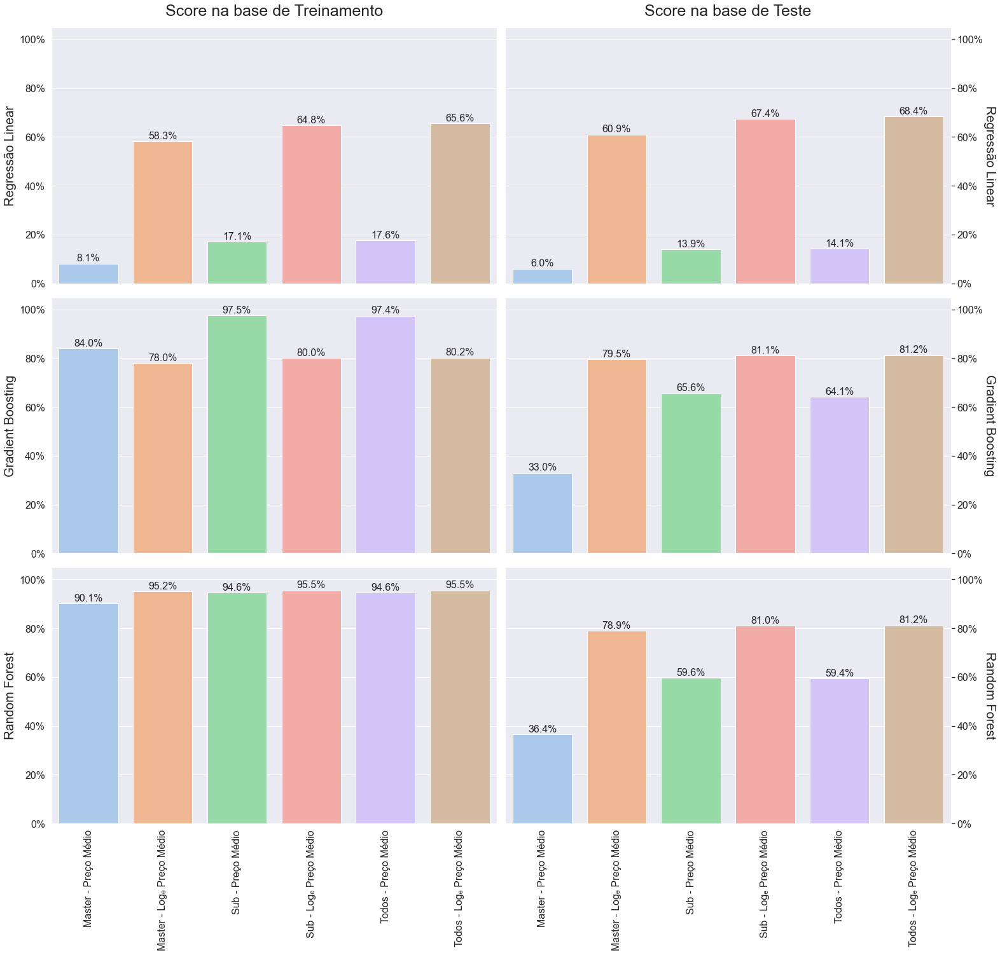

In [72]:
sns.set()
rotate_y = 0
rotate_x = 90
rotate_l = 0
font = 16
font_title = 25 - font 
font_ax = 20 - font
df_results.sort_index(inplace=True)
data0 = df_results[df_results['Alg']=='LR'].sort_index()
data1 = df_results[df_results['Alg']=='GB'].sort_index()
data2 = df_results[df_results['Alg']=='RF'].sort_index()

fig, ax = plt.subplots(3,2, figsize=(22, 21), sharex=True)

sns.barplot(ax=ax[0,0],x = data0['Name'],
            y = data0['Train_score'],
            ci = None,
            palette='pastel')
for rect in ax[0,0].patches:
    ax[0,0].text (rect.get_x() + rect.get_width()  / 2,
                rect.get_height()+ 0.01,
                str('{:1,.1f}%'.format(rect.get_height()*100)),
                horizontalalignment='center', 
                rotation=rotate_l, 
                fontsize = font)
ax[0,0].set(ylim=(0, 1.05))
ax[0,0].yaxis.set_major_locator(mtick.FixedLocator(ax[0,0].get_yticks()))
ax[0,0].set_yticklabels(ax[0,0].get_yticklabels(), rotation=rotate_y, fontsize=font)
ax[0,0].set_xticklabels(ax[0,0].get_xticklabels(), rotation=rotate_x,fontsize=font)
ax[0,0].yaxis.set_major_formatter(mtick.PercentFormatter(xmax=1, decimals=None, symbol='%', is_latex=False))
ax[0,0].set_title('Score na base de Treinamento',fontsize = font+font_title, y=1.03)
ax[0,0].set_xlabel('', fontsize = font+font_ax)
ax[0,0].set_ylabel('Regressão Linear', fontsize = font+font_ax)

sns.barplot(ax=ax[0,1],x = data0['Name'],
            y = data0['Test_score'],
            ci = None,
            palette='pastel')
for rect in ax[0,1].patches:
    ax[0,1].text (rect.get_x() + rect.get_width()  / 2,
                rect.get_height()+ 0.01,
                str('{:1,.1f}%'.format(rect.get_height()*100)),
                horizontalalignment='center', 
                rotation=rotate_l, 
                fontsize = font)
ax[0,1].set(ylim=(0, 1.05))
ax[0,1].yaxis.set_major_locator(mtick.FixedLocator(ax[0,1].get_yticks()))
ax[0,1].set_yticklabels(ax[0,1].get_yticklabels(), rotation=rotate_y, fontsize=font)
ax[0,1].set_xticklabels(ax[0,1].get_xticklabels(), rotation=rotate_x,fontsize=font)
ax[0,1].yaxis.set_major_formatter(mtick.PercentFormatter(xmax=1, decimals=None, symbol='%', is_latex=False))
ax[0,1].set_title('Score na base de Teste',fontsize = font+font_title, y=1.03)
ax[0,1].set_xlabel('', fontsize = font+3)
ax[0,1].set_ylabel('Regressão Linear', labelpad=20, fontsize = font+font_ax, rotation=270)
ax[0,1].yaxis.tick_right()
ax[0,1].yaxis.set_label_position('right')

sns.barplot(ax=ax[1,0],x = data1['Name'],
            y = data1['Train_score'],
            ci = None,
            palette='pastel')
for rect in ax[1,0].patches:
    ax[1,0].text (rect.get_x() + rect.get_width()  / 2,
                rect.get_height()+ 0.01,
                str('{:1,.1f}%'.format(rect.get_height()*100)),
                horizontalalignment='center', 
                rotation=rotate_l, 
                fontsize = font)
ax[1,0].set(ylim=(0, 1.05))
ax[1,0].yaxis.set_major_locator(mtick.FixedLocator(ax[1,0].get_yticks()))
ax[1,0].set_yticklabels(ax[1,0].get_yticklabels(), rotation=rotate_y, fontsize=font)
ax[1,0].set_xticklabels(ax[1,0].get_xticklabels(), rotation=rotate_x,fontsize=font)
ax[1,0].yaxis.set_major_formatter(mtick.PercentFormatter(xmax=1, decimals=None, symbol='%', is_latex=False))
ax[1,0].set_xlabel('', fontsize = font+font_ax)
ax[1,0].set_ylabel('Gradient Boosting', fontsize = font+font_ax)

sns.barplot(ax=ax[1,1],x = data1['Name'],
            y = data1['Test_score'],
            ci = None,
            palette='pastel')
for rect in ax[1,1].patches:
    ax[1,1].text (rect.get_x() + rect.get_width()  / 2,
                rect.get_height()+ 0.01,
                str('{:1,.1f}%'.format(rect.get_height()*100)),
                horizontalalignment='center', 
                rotation=rotate_l, 
                fontsize = font)
ax[1,1].set(ylim=(0, 1.05))
ax[1,1].yaxis.set_major_locator(mtick.FixedLocator(ax[1,1].get_yticks()))
ax[1,1].set_yticklabels(ax[1,1].get_yticklabels(), rotation=rotate_y, fontsize=font)
ax[1,1].set_xticklabels(ax[1,1].get_xticklabels(), rotation=rotate_x,fontsize=font)
ax[1,1].yaxis.set_major_formatter(mtick.PercentFormatter(xmax=1, decimals=None, symbol='%', is_latex=False))
ax[1,1].set_xlabel('', fontsize = font+font_ax)
ax[1,1].set_ylabel('Gradient Boosting', labelpad=20, fontsize = font+font_ax, rotation=270)
ax[1,1].yaxis.tick_right()
ax[1,1].yaxis.set_label_position('right')

sns.barplot(ax=ax[2,0],x = data2['Name'],
            y = data2['Train_score'],
            ci = None,
            palette='pastel')
for rect in ax[2,0].patches:
    ax[2,0].text (rect.get_x() + rect.get_width()  / 2,
                rect.get_height()+ 0.01,
                str('{:1,.1f}%'.format(rect.get_height()*100)),
                horizontalalignment='center', 
                rotation=rotate_l, 
                fontsize = font)
ax[2,0].set(ylim=(0, 1.05))
ax[2,0].yaxis.set_major_locator(mtick.FixedLocator(ax[2,0].get_yticks()))
ax[2,0].set_yticklabels(ax[2,0].get_yticklabels(), rotation=rotate_y, fontsize=font)
ax[2,0].set_xticklabels(ax[2,0].get_xticklabels(), rotation=rotate_x,fontsize=font)
ax[2,0].yaxis.set_major_formatter(mtick.PercentFormatter(xmax=1, decimals=None, symbol='%', is_latex=False))
ax[2,0].set_xlabel('', fontsize = font+font_ax)
ax[2,0].set_ylabel('Random Forest', fontsize = font+font_ax)

sns.barplot(ax=ax[2,1],x = data2['Name'],
            y = data2['Test_score'],
            ci = None,
            palette='pastel')
for rect in ax[2,1].patches:
    ax[2,1].text (rect.get_x() + rect.get_width()  / 2,
                rect.get_height()+ 0.01,
                str('{:1,.1f}%'.format(rect.get_height()*100)),
                horizontalalignment='center', 
                rotation=rotate_l, 
                fontsize = font)
ax[2,1].set(ylim=(0, 1.05))
ax[2,1].yaxis.set_major_locator(mtick.FixedLocator(ax[2,1].get_yticks()))
ax[2,1].set_yticklabels(ax[2,1].get_yticklabels(), rotation=rotate_y, fontsize=font)
ax[2,1].set_xticklabels(ax[2,1].get_xticklabels(), rotation=rotate_x,fontsize=font)
ax[2,1].yaxis.set_major_formatter(mtick.PercentFormatter(xmax=1, decimals=None, symbol='%', is_latex=False))
ax[2,1].set_xlabel('', fontsize = font+font_ax)
ax[2,1].set_ylabel('Random Forest', labelpad=20, fontsize = font+font_ax, rotation=270)
ax[2,1].yaxis.tick_right()
ax[2,1].yaxis.set_label_position('right')

ax[0,0].set_xticklabels(['Master - Preço Médio','Master - Log\u2091 Preço Médio','Sub - Preço Médio','Sub - Log\u2091 Preço Médio','Todos - Preço Médio','Todos - Log\u2091 Preço Médio'])

ax[0,0].tick_params(axis='y', labelsize=font)
ax[1,0].tick_params(axis='y', labelsize=font)
ax[2,0].tick_params(axis='y', labelsize=font)
ax[2,0].tick_params(axis='x', labelsize=font)
ax[2,1].tick_params(axis='x', labelsize=font)

plt.tight_layout()
plt.show()



#### Ranking por R2 Score

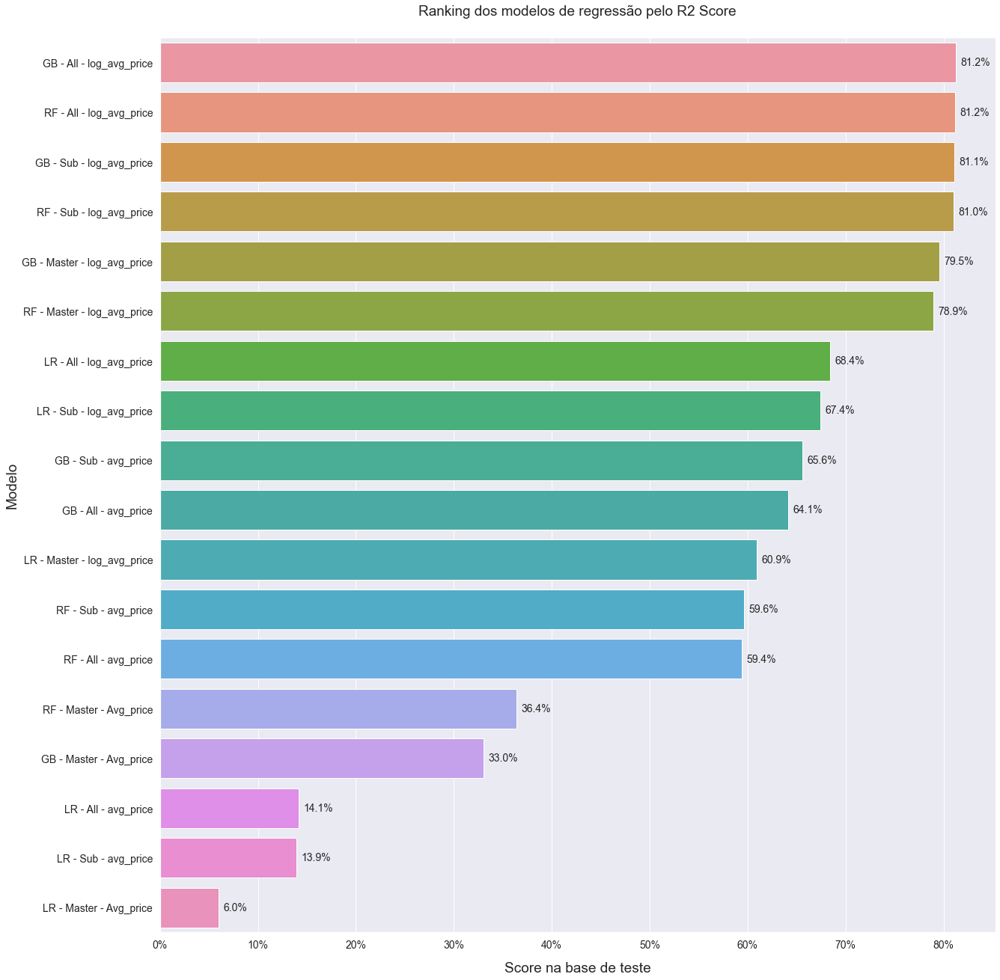

In [73]:
sns.set()
rotate_y = 0
rotate_x = 0
font = 14
df_results.sort_values(by ='Test_score', ascending=False, inplace=True)

fig, ax = plt.subplots(1,1, figsize=(20, 22))

sns.barplot(y = df_results['Name'],
            x = df_results['Test_score'],
            ci = None,
            orient ='h')
for i, v in enumerate(df_results.Test_score):
    plt.text(v+0.005, 
             i, 
             str('{:1,.1f}%'.format(v*100)), 
             va='center',
             fontsize = font)

ax.xaxis.set_major_locator(mtick.FixedLocator(ax.get_xticks()))
ax.set_yticklabels(ax.get_yticklabels(), rotation=rotate_y, fontsize=font)
ax.set_xticklabels(ax.get_xticklabels(), rotation=rotate_x,fontsize=font)
ax.xaxis.set_major_formatter(mtick.PercentFormatter(xmax=1, decimals=None, symbol='%', is_latex=False))
ax.set_title('Ranking dos modelos de regressão pelo R2 Score', fontsize = font+5, y=1.02)
ax.set_xlabel('Score na base de teste', fontsize = font+5, labelpad = 15)
ax.set_ylabel('Modelo', fontsize = font+5)
plt.show()

## Avaliação de atributos importantes
#### Comparação Random Forest e Gradient Boosting com Todos atibutos prevendo log preço médio

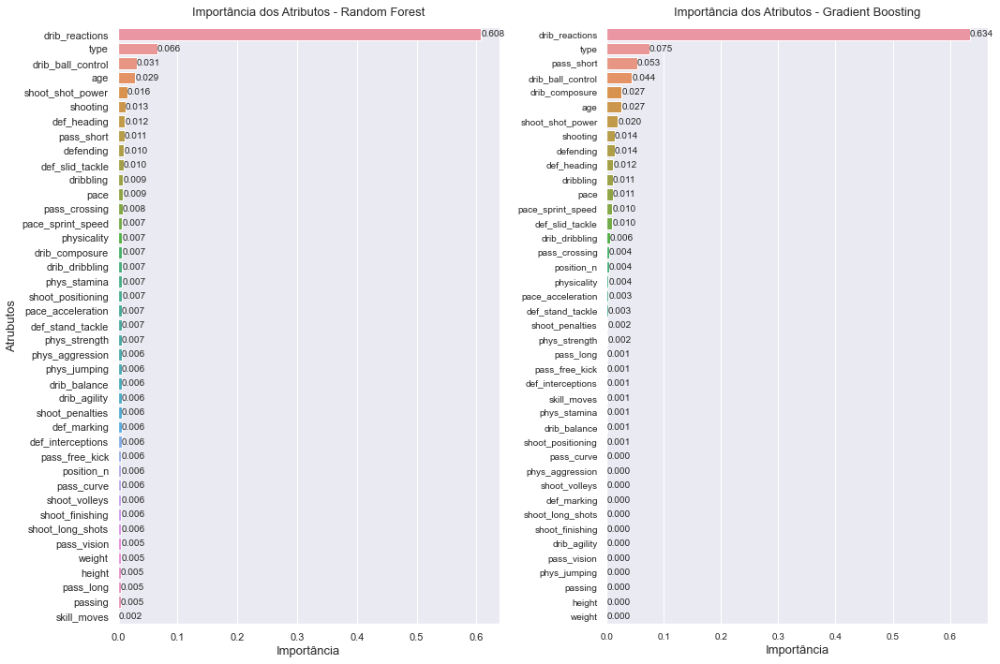

In [74]:
x = df[['position_n','type','pace','dribbling','shooting','passing','defending','physicality',
        'age','height','weight','skill_moves','pace_acceleration', 'pace_sprint_speed', 'drib_agility', 'drib_balance', 
        'drib_reactions', 'drib_ball_control', 'drib_dribbling', 'drib_composure', 'shoot_positioning', 'shoot_finishing', 
        'shoot_shot_power', 'shoot_long_shots', 'shoot_volleys', 'shoot_penalties', 'pass_vision', 'pass_crossing', 
        'pass_free_kick', 'pass_short', 'pass_long', 'pass_curve', 'def_interceptions', 'def_heading', 'def_marking', 
        'def_stand_tackle', 'def_slid_tackle', 'phys_jumping', 'phys_stamina', 'phys_strength', 'phys_aggression']]
y = df['log_avg_price']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.33, random_state=25)

rf = RandomForestRegressor(random_state=0).fit(x_train, y_train)
rf_sorted_idx = rf.feature_importances_.argsort()

gb = GradientBoostingRegressor(random_state=0).fit(x_train, y_train)
gb_sorted_idx = gb.feature_importances_.argsort()

sns.set()
rotate_y = 0
rotate_x = 0
font = 10

fig, ax = plt.subplots(1,2, figsize=(15, 10))

sns.barplot(ax=ax[0],
            x = rf.feature_importances_[rf_sorted_idx][::-1],
            y = x.columns.values[rf_sorted_idx][::-1],
            ci = None,
            orient ='h')

for p in ax[0].patches:
    width = p.get_width()
    ax[0].text(width + 0.0001,
            p.get_y() + p.get_height() / 2,
            '{:1.3f}'.format(width),
            ha = 'left',
            va = 'center',
            fontsize = font)

sns.barplot(ax=ax[1],
            x = gb.feature_importances_[gb_sorted_idx][::-1],
            y = x.columns.values[gb_sorted_idx][::-1],
            ci = None,
            orient ='h')

for p in ax[1].patches:
    width = p.get_width()
    ax[1].text(width + 0.0001,
            p.get_y() + p.get_height() / 2,
            '{:1.3f}'.format(width),
            ha = 'left',
            va = 'center',
            fontsize = font)
    
ax[0].set_title('Importância dos Atributos - Random Forest', fontsize = font+3, y=1.01)
ax[1].set_title('Importância dos Atributos - Gradient Boosting', fontsize = font+3, y=1.01)#ax.set_xlabel('Score na base de teste', fontsize = font+5, labelpad = 15)
ax[0].set_ylabel('Atrubutos', fontsize = font+3)
ax[0].set_xlabel('Importância', fontsize = font+3)
ax[1].set_xlabel('Importância', fontsize = font+3)
plt.xticks(size=font)
plt.yticks(size=font)
plt.tight_layout()
plt.show()

#### Execução dos modelos somente com atributos relevantes

In [75]:
x = df[['drib_reactions','type','drib_ball_control','age']]
y = df['log_avg_price']

name = 'RF - Tuned - log_avg_price'
alg = 'RF'
features = 'Tuned'
target = 'log_avg_price'
model = RandomForestRegressor(random_state=0).fit(x_train, y_train)
y_pred = model.predict(x_test)
print('Train Score: '+ str(model.score(x_train, y_train)))
print('Test Score: '+ str(model.score(x_test, y_test)))
indexNames = df_results[df_results['Name'] == name ].index
df_results.drop(indexNames , inplace=True)
df_results.reset_index(drop=True, inplace=True)
show_metrics(y_test, y_pred)
df_results.loc[len(df_results)] = store_metrics(y_test, y_pred, name, alg, features, target)
df_results


Train Score: 0.9552343031677287
Test Score: 0.8115105426872562
r2_score: 0.8115105426872562 
 mae: 0.576352203642435 
 mse: 0.5122623862598362 
 rmse: 0.7157250772886445


,Name,Alg,Features,Target,Train_score,Test_score
0,GB - All - log_avg_price,GB,All,log_avg_price,0.80,0.81
1,RF - All - log_avg_price,RF,All,log_avg_price,0.96,0.81
2,GB - Sub - log_avg_price,GB,Sub,log_avg_price,0.80,0.81
3,RF - Sub - log_avg_price,RF,Sub,log_avg_price,0.96,0.81
4,GB - Master - log_avg_price,GB,Master,log_avg_price,0.78,0.80
5,RF - Master - log_avg_price,RF,Master,log_avg_price,0.95,0.79
6,LR - All - log_avg_price,LR,All,log_avg_price,0.66,0.68
7,LR - Sub - log_avg_price,LR,Sub,log_avg_price,0.65,0.67
8,GB - Sub - avg_price,GB,Sub,avg_price,0.98,0.66
9,GB - All - avg_price,GB,All,avg_price,0.97,0.64


In [76]:
x = df[['drib_reactions','type','pass_short','drib_ball_control','drib_composure','age','shoot_shot_power']]
y = df['log_avg_price']

name = 'GB - Tuned - log_avg_price'
alg = 'GB'
features = 'Tuned'
target = 'log_avg_price'
model = GradientBoostingRegressor(random_state=0).fit(x_train, y_train)
y_pred = model.predict(x_test)
print('Train Score: '+ str(model.score(x_train, y_train)))
print('Test Score: '+ str(model.score(x_test, y_test)))
indexNames = df_results[df_results['Name'] == name ].index
df_results.drop(indexNames , inplace=True)
df_results.reset_index(drop=True, inplace=True)
show_metrics(y_test, y_pred)
df_results.loc[len(df_results)] = store_metrics(y_test, y_pred, name, alg, features, target)
df_results

Train Score: 0.8019095562496752
Test Score: 0.8122095629533835
r2_score: 0.8122095629533835 
 mae: 0.5761529502142215 
 mse: 0.5103626418673621 
 rmse: 0.714396697827868


,Name,Alg,Features,Target,Train_score,Test_score
0,GB - All - log_avg_price,GB,All,log_avg_price,0.80,0.81
1,RF - All - log_avg_price,RF,All,log_avg_price,0.96,0.81
2,GB - Sub - log_avg_price,GB,Sub,log_avg_price,0.80,0.81
3,RF - Sub - log_avg_price,RF,Sub,log_avg_price,0.96,0.81
4,GB - Master - log_avg_price,GB,Master,log_avg_price,0.78,0.80
5,RF - Master - log_avg_price,RF,Master,log_avg_price,0.95,0.79
6,LR - All - log_avg_price,LR,All,log_avg_price,0.66,0.68
7,LR - Sub - log_avg_price,LR,Sub,log_avg_price,0.65,0.67
8,GB - Sub - avg_price,GB,Sub,avg_price,0.98,0.66
9,GB - All - avg_price,GB,All,avg_price,0.97,0.64


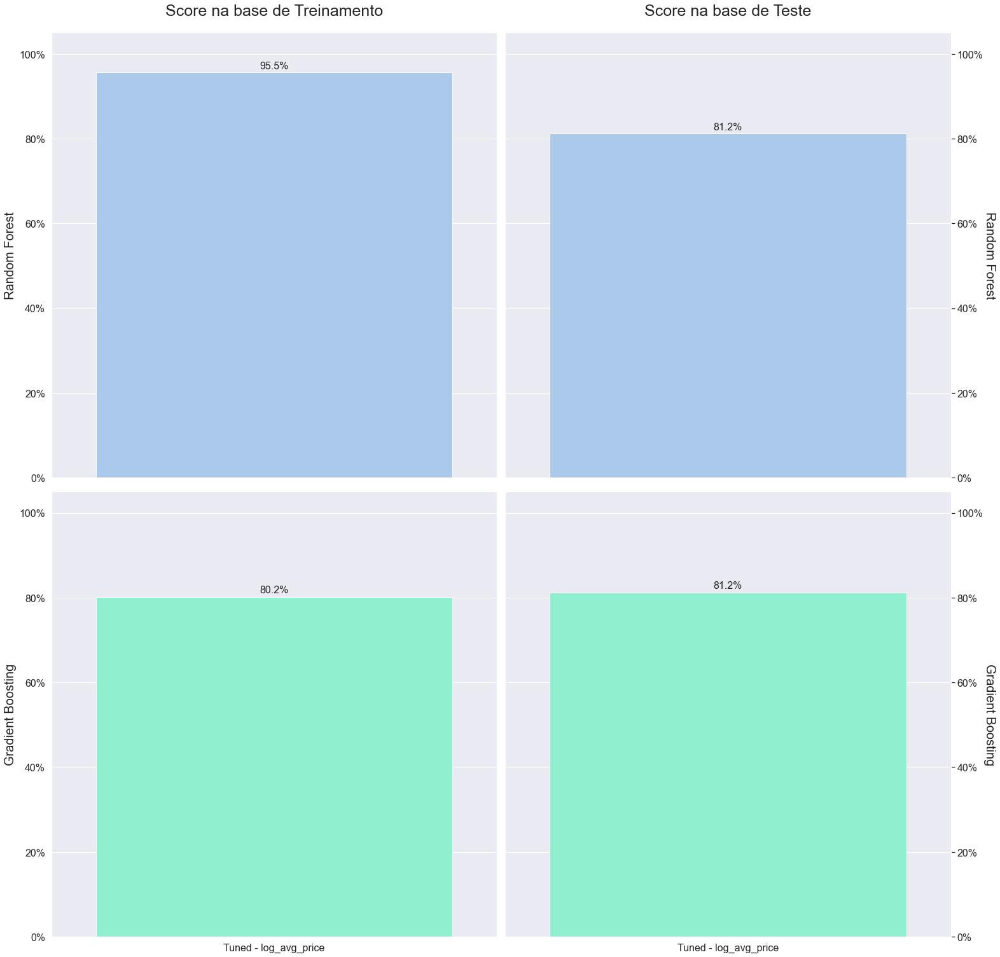

In [77]:
sns.set()
rotate_y = 0
rotate_x = 0
rotate_l = 0
font = 16
font_title = 25 - font 
font_ax = 20 - font
df_results.sort_index(inplace=True)
data0 = df_results[(df_results['Alg']=='RF') & (df_results['Features']=='Tuned')].sort_index()
data1 = df_results[(df_results['Alg']=='GB') & (df_results['Features']=='Tuned')].sort_index()


fig, ax = plt.subplots(2,2, figsize=(22, 21), sharex=True)

sns.barplot(ax=ax[0,0],x = data0['Name'],
            y = data0['Train_score'],
            ci = None,
            palette='pastel')
for rect in ax[0,0].patches:
    ax[0,0].text (rect.get_x() + rect.get_width()  / 2,
                rect.get_height()+ 0.01,
                str('{:1,.1f}%'.format(rect.get_height()*100)),
                horizontalalignment='center', 
                rotation=rotate_l, 
                fontsize = font)
ax[0,0].set(ylim=(0, 1.05))
ax[0,0].yaxis.set_major_locator(mtick.FixedLocator(ax[0,0].get_yticks()))
ax[0,0].set_yticklabels(ax[0,0].get_yticklabels(), rotation=rotate_y, fontsize=font)
ax[0,0].set_xticklabels(ax[0,0].get_xticklabels(), rotation=rotate_x,fontsize=font)
ax[0,0].yaxis.set_major_formatter(mtick.PercentFormatter(xmax=1, decimals=None, symbol='%', is_latex=False))
ax[0,0].set_title('Score na base de Treinamento',fontsize = font+font_title, y=1.03)
ax[0,0].set_xlabel('', fontsize = font+font_ax)
ax[0,0].set_ylabel('Random Forest', fontsize = font+font_ax)

sns.barplot(ax=ax[0,1],x = data0['Name'],
            y = data0['Test_score'],
            ci = None,
            palette='pastel')
for rect in ax[0,1].patches:
    ax[0,1].text (rect.get_x() + rect.get_width()  / 2,
                rect.get_height()+ 0.01,
                str('{:1,.1f}%'.format(rect.get_height()*100)),
                horizontalalignment='center', 
                rotation=rotate_l, 
                fontsize = font)
ax[0,1].set(ylim=(0, 1.05))
ax[0,1].yaxis.set_major_locator(mtick.FixedLocator(ax[0,1].get_yticks()))
ax[0,1].set_yticklabels(ax[0,1].get_yticklabels(), rotation=rotate_y, fontsize=font)
ax[0,1].set_xticklabels(ax[0,1].get_xticklabels(), rotation=rotate_x,fontsize=font)
ax[0,1].yaxis.set_major_formatter(mtick.PercentFormatter(xmax=1, decimals=None, symbol='%', is_latex=False))
ax[0,1].set_title('Score na base de Teste',fontsize = font+font_title, y=1.03)
ax[0,1].set_xlabel('', fontsize = font+3)
ax[0,1].set_ylabel('Random Forest', labelpad=20, fontsize = font+font_ax, rotation=270)
ax[0,1].yaxis.tick_right()
ax[0,1].yaxis.set_label_position('right')

sns.barplot(ax=ax[1,0],x = data1['Name'],
            y = data1['Train_score'],
            ci = None,
            color='aquamarine')
for rect in ax[1,0].patches:
    ax[1,0].text (rect.get_x() + rect.get_width()  / 2,
                rect.get_height()+ 0.01,
                str('{:1,.1f}%'.format(rect.get_height()*100)),
                horizontalalignment='center', 
                rotation=rotate_l, 
                fontsize = font)
ax[1,0].set(ylim=(0, 1.05))
ax[1,0].yaxis.set_major_locator(mtick.FixedLocator(ax[1,0].get_yticks()))
ax[1,0].set_yticklabels(ax[1,0].get_yticklabels(), rotation=rotate_y, fontsize=font)
ax[1,0].set_xticklabels(ax[1,0].get_xticklabels(), rotation=rotate_x,fontsize=font)
ax[1,0].yaxis.set_major_formatter(mtick.PercentFormatter(xmax=1, decimals=None, symbol='%', is_latex=False))
ax[1,0].set_xlabel('', fontsize = font+font_ax)
ax[1,0].set_ylabel('Gradient Boosting', fontsize = font+font_ax)

sns.barplot(ax=ax[1,1],x = data1['Name'],
            y = data1['Test_score'],
            ci = None,
            color='aquamarine')
for rect in ax[1,1].patches:
    ax[1,1].text (rect.get_x() + rect.get_width()  / 2,
                rect.get_height()+ 0.01,
                str('{:1,.1f}%'.format(rect.get_height()*100)),
                horizontalalignment='center', 
                rotation=rotate_l, 
                fontsize = font)
ax[1,1].set(ylim=(0, 1.05))
ax[1,1].yaxis.set_major_locator(mtick.FixedLocator(ax[1,1].get_yticks()))
ax[1,1].set_yticklabels(ax[1,1].get_yticklabels(), rotation=rotate_y, fontsize=font)
ax[1,1].set_xticklabels(ax[1,1].get_xticklabels(), rotation=rotate_x,fontsize=font)
ax[1,1].yaxis.set_major_formatter(mtick.PercentFormatter(xmax=1, decimals=None, symbol='%', is_latex=False))
ax[1,1].set_xlabel('', fontsize = font+font_ax)
ax[1,1].set_ylabel('Gradient Boosting', labelpad=20, fontsize = font+font_ax, rotation=270)
ax[1,1].yaxis.tick_right()
ax[1,1].yaxis.set_label_position('right')


ax[0,0].set_xticklabels(['Tuned - log_avg_price'])

ax[0,0].tick_params(axis='y', labelsize=font)
ax[1,0].tick_params(axis='y', labelsize=font)
ax[1,0].tick_params(axis='x', labelsize=font)
ax[1,1].tick_params(axis='x', labelsize=font)



plt.tight_layout()
plt.show()

